# HB2D correction coil cheeky test cycle 503
***

## Defining various useful functions and constants

In [64]:
import scipy as sp
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
from os.path import isdir,isfile
import warnings,csv
from datetime import datetime
import matplotlib.dates as dates

laptop_direct = "C:/Users/samck/Desktop/Correction coil data/"  #where the data is

DEFAULT_DIRECT = laptop_direct  #can also be changed in function calls
DEFAULT_SPICE_LOG_DIRECT = laptop_direct

assert isdir(DEFAULT_DIRECT), 'Default directory is not found!'
print(f'Default directory: {DEFAULT_DIRECT}')
assert isdir(DEFAULT_SPICE_LOG_DIRECT), 'Default SpICE log directory is not found!'
print(f'Default spice log directory: {DEFAULT_SPICE_LOG_DIRECT}')

SMALL_SIZE,MEDIUM_SIZE,BIGGER_SIZE = 20,25,35
plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title
plt.rc('axes', titlesize=BIGGER_SIZE)    # actually gets title font size (glitch in matplotlib?)

pixels_to_mm = .080  #0.227 mm per pixel in Anger camera
CL = -4.63  #larmor constant (in Gauss and Angstroms)
LAM = 4.25  #HB2D wavelength (1% delta lambda)
DLAM = LAM*.01

def cos(x,amp,freq,phase,shim,offset):
    """Returns a cosine with ampitude, frequency, phase, shim, and offset."""
    return amp*np.cos(freq*(x - offset) + phase) + shim

def get_flip(dist,gpa,lam=LAM,flip=np.pi,show=True):
    """Returns the current required for pi or pi/2 flip."""
    result = round(flip/(CL*gpa*lam*dist*1e-2),2)
    if show: print(f'Current required for a {round(flip,2)} flip: {result} amps')
    return result

def frp_convert(value,show=False):
    """Convert polarization to flipping ratio and vice-versa."""
    assert value != 1, 'FR is infinite when polarization is unity!'
    if value > 1:
        result = (value - 1)/(value + 1)
        something = f'FR: {round(value,3)} \n Pol: {round(result*100,1)}%'
    else:
        result = (1 + value)/(1 - value)
        something = f'FR: {round(result,3)} \n Pol: {round(value*100,1)}%'
    if show: print(something)
    return result

def get_res(D,Ls,Ld,show=True):
    """Calculates geometric resolution."""
    res = D*Ls/Ld
    if show: print(f'Geometric resolution: {round(res,3)} (mm) \n')
    return res

def get_focus(f1,f2,delta,show=False):
    """Returns focusing condition for flippers in MIEZE-mode.
    Frequency is assumed to be in kHz."""
    assert f2 > f1, 'f1 > f2!'
    result = delta/2*(f2 + f1)/(f2 - f1)
    if show:
        print(f'Detector distance: {round(result,2)} cm')
        print(f'MIEZE frequency: {round(f2-f1,2)} kHz')
        print(f'Modulation frequency: {round(2*(f2-f1),2)} kHz')
    return result

gn = -1.832471e8  #gyromagnetic ratio of neutron (rad/T/m^2)
mn = 1.674927e-27  #mass of neutron (kg)
hbar = 1.054571e-34  #reduced plancks constant (kg m^2/s)
cl_si = gn/(hbar*2*np.pi)*mn  #Larmor constant (SI units)

def get_depol(I,FIperAMP=0.1686*1e-3,dlam=DLAM*1e-10,show=False):
    """Estimates the depolarization from wavelength spread.
    FIperAMP is in Tesla meters per amp."""
    phase_diff = cl_si*FIperAMP*I*dlam
    if show: print(f'Difference in Larmor phase from wavelength spread: {round(phase_diff,3)}')
    return phase_diff

_ = get_depol(I=10.,show=True)
_ = get_depol(I=20.,show=True)

Default directory: C:/Users/samck/Desktop/Correction coil data/
Default spice log directory: C:/Users/samck/Desktop/Correction coil data/
Difference in Larmor phase from wavelength spread: -3.319
Difference in Larmor phase from wavelength spread: -6.638


In [2]:
def new_reduce(subscans,print_fnames=False,print_raw=False,print_BGsub=False,print_ROI=False,print_summed=False,\
               ROI_x=(200,350),ROI_y=(200,350),tof=True,time_bins=33,ROI_t=(0,32),direct=DEFAULT_DIRECT):
    """Returns the summed, background (BG) corrected, region of interest (ROI) 2d array of counts.
    The various print function optional arguments show the data processing step by step.
    The final image summed from the subscans is the last optional argument.
    Includes option for reducing time-dependent data. Clock frequency should be 2*(f2-f1)."""
    assert isdir(direct), 'Data directory is not found!'
    if isinstance(subscans,int):
        subscans = [subscans]  #allows for integer input
    
    if tof:
        assert time_bins > 0, 'Number of time bins must be positive!'
        filenames = [f'{direct}CG4B_Matt{i}/tofhisto.dat' for i in subscans]
    else:
        filenames = [f'{direct}CG4B_{i}/sipm2d.dat' for i in subscans]
        
    for f in filenames:
        assert isfile(f), f'Datafile {f} was not found!'
    if print_fnames:
        print("Files used:",filenames)
    ROIImages = []  #stores the background corrected region of interest
    for indx,filename in enumerate(filenames):
        if tof: raw_image = np.fromfile(filename,dtype=np.uint32).reshape(512,512,time_bins).T  #time is first axis
        else: raw_image = np.fromfile(filename,dtype=np.uint32).reshape(512,512).T
        if print_raw:
            print('***Raw Image***')
            if tof: _ = ShowImage_tof(raw_image)
            else: ShowImage(raw_image)

        if tof: BG_pixels = raw_image[:,0:20:,0:20:]  #set pixel range for background subtraction here
        else: BG_pixels = raw_image[0:20:,0:20:]
        BG_sum = np.sum(BG_pixels)
        BGperpixel =  float(BG_sum/np.size(BG_pixels))
        BGC_image = raw_image - BGperpixel
        if print_BGsub:
            print("***BG subtracted image***")
            print("Subscan name: ",filename)
            print("BG per pixel: ",BGperpixel)
            if tof: _ = ShowImage_tof(BGC_image)
            else: ShowImage(BGC_image)
        
        if tof: ROI_image = BGC_image[ROI_t[0]:ROI_t[1]:,ROI_y[0]:ROI_y[1]:,ROI_x[0]:ROI_x[1]:]
        else: ROI_image = BGC_image[ROI_y[0]:ROI_y[1]:,ROI_x[0]:ROI_x[1]:]
        if print_ROI:
            print("***Region of interest***")
            if tof: _ = ShowImage_tof(ROI_image)
            else: 
                print("Total counts in ROI: ",np.sum(ROI_image),"\n")
                ShowImage(ROI_image)
        ROIImages.append(ROI_image)

    summedROI = np.sum(ROIImages,axis=0)
    if print_summed:
        print("***Combined image of all subscans***")
        if tof: _ = ShowImage_tof(summedROI)
        else:
            print("Total counts in summed ROI: ",np.sum(summedROI))
            ShowImage(summedROI)
    return summedROI

def ShowImage(inImage):
    """Plots non-tof image in the reduction function."""
    fig,ax = plt.subplots(1,1,figsize=(8,6))
    im = ax.imshow(inImage,origin="lower",aspect="auto")
    fig.colorbar(im)
    fig.tight_layout()
    plt.show()

def ShowImage_tof(raw_tof):
    """Plots images in the tof reduction function. Returns max and min counts time bin."""
    tof = np.sum(raw_tof,axis=(1,2))
    max_indx = np.argmax(tof)  #time bin with maximum counts
    min_indx = np.argmin(tof)  #time bin with minimum counts
    high = raw_tof[max_indx,:,:]
    low = raw_tof[min_indx,:,:]
    fig,ax = plt.subplots(1,3,figsize=(20,6))
    im1 = ax[0].imshow(high,origin="lower",aspect="auto")
    ax[0].set_title(f'Max={round(tof[max_indx])}, bin={max_indx}')
    plt.colorbar(im1,ax=ax[0],shrink=.8)
    im2 = ax[1].imshow(low,origin="lower",aspect="auto")
    ax[1].set_title(f'Min={round(tof[min_indx])}, bin={min_indx}')
    plt.colorbar(im2,ax=ax[1],shrink=.8)
    ax[2].set_title('Entire ROI tof')
    ax[2].set_xlabel('time channel')
    ax[2].plot(tof)
    ax[2].errorbar(range(len(tof)),tof,np.sqrt(tof),ls='none',color='C0')
    ax[2].grid()
    plt.tight_layout()
    plt.show()
    return max_indx,min_indx

def rebin_tof(tof,new_bins=(1,1),show_rebin=True):
    """Rebins the spatial part of the time-of-flight signal.
    The new_bins parameter is the number of bins summed in x and y."""
    old_bins = np.shape(tof)
    assert old_bins[1]%new_bins[0] == old_bins[2]%new_bins[1] == 0, f'New bin number {new_bins} must divide old bin number {old_bins}!'

    new_tof = np.array([tof[t,:,:].reshape(old_bins[1]//new_bins[0],new_bins[0],old_bins[2]//new_bins[1],new_bins[1]).sum(axis=(1,3)) for t in range(old_bins[0])])
    if show_rebin: _ = ShowImage_tof(new_tof)
    return new_tof

def mega_fit(tof,f=lambda x,amp,freq,phase,shim: cos(x,amp,freq,phase,shim,0),show_pol=True,error_max=.5,supress_errors=True,
            show_contextual_region=False,check_fit=False,fit_indxs=[]):
    """Fits each pixel in tof to a input function f. The default function is a 
    cosine with amplitude, frequency, phase, and shim without an offset."""
    fits,errors = [],[]
    t_bins,x_bins,y_bins = np.shape(tof)
    t = np.array(range(t_bins))
    
    for x in range(x_bins):
        for y in range(y_bins):
            fiber = tof[:,x,y]
            lb = (0,2*np.pi/(t_bins+20),-np.pi,0)
            ub = (np.max(fiber),2*np.pi/(t_bins-20),np.pi,np.max(fiber))
            bnds = (lb,ub)  #lower and upper bounds

            guess = [(np.max(fiber)-np.min(fiber))/2,2*np.pi/t_bins,0,(np.max(fiber)+np.min(fiber))/2]
            if guess[0]<=0 or guess[-1]<=0:
                if not supress_errors: print(f'Pixel ({x,y}) has zero counts!')
                fits.append(np.array([0]*4))
                errors.append(np.array([np.inf]*4))
            else:
                guess[2] = (fiber[0] - (np.max(fiber) + np.min(fiber))/2)/(np.max(fiber) - np.min(fiber))  #phase guess
                try:
                    with warnings.catch_warnings():
                        warnings.simplefilter("ignore")  #ignores nan mulitply and zero divide warnings
                        parms,errs = curve_fit(f,t,fiber,p0=guess,sigma=np.sqrt(fiber),bounds=bnds)
                    fits.append(parms)
                    errors.append(np.sqrt(np.diag(errs)))
                except:
                    if not supress_errors: print(f'Pixel ({x,y}) fitting failed!')
                    errs = np.array([np.inf,np.inf,np.inf,np.inf])
                    fits.append(np.array([0]*4))
                    errors.append(np.array([np.inf]*4))
    fits = np.array(fits)
    fits = fits.reshape(x_bins,y_bins,len(fits[0]))
    errors = np.array(errors)
    errors = errors.reshape(x_bins,y_bins,len(errors[0]))
    
    if show_pol:
        fig,ax = plt.subplots(nrows=1,ncols=2,figsize=(10,4))
        with warnings.catch_warnings():
            warnings.simplefilter("ignore")  #ignores nan mulitply and zero divide warnings
            if show_contextual_region: vmin = .725  #rough bound for contextuality witness
            else: vmin = None
            P = fits[:,:,0]/fits[:,:,-1]
            im1 = ax[0].imshow(P,origin='lower',vmin=vmin,vmax=min(1,np.max(P)))
        ax[0].set_title('Fitted Pol')
        plt.colorbar(im1,ax=ax[0],shrink=.75)

        with warnings.catch_warnings():
            warnings.simplefilter("ignore")  #ignores nan mulitply and zero divide warnings
            im2 = ax[1].imshow(np.sqrt(1/fits[:,:,0]+1/fits[:,:,-1]),origin='lower',vmin=0,vmax=error_max)
        ax[1].set_title('Rel. Error')
        plt.colorbar(im2,ax=ax[1],shrink=.75)
        plt.tight_layout()
        plt.show()

    if check_fit:
        fig,ax = plt.subplots(nrows=1,ncols=1,figsize=(8,4))
        for pnt,(x,y) in enumerate(fit_indxs):
            plt.plot(t,tof[:,x,y],'o',label=f'{x,y}',color=f'C{pnt}')
            plt.plot(t,f(t,*fits[x,y]),'-',color=f'C{pnt}')
            print(f'{x,y} parameters, errors, pol:')
            print(f'{fits[x,y]}')
            print(f'{errors[x,y]}')
            print(f'{fits[x,y,0]/fits[x,y,-1]}')
        plt.grid()
        plt.xlabel('Time channel')
        plt.legend()
        plt.tight_layout()
        plt.show()
    
    return fits,errors

def spice_log_reader(scan,direct=DEFAULT_SPICE_LOG_DIRECT,show=False):
    """Finds the scan parameters from the Spice logfile.txt file.
    Returns scan number, scan title, date/time, and SpICE motor settings."""
    assert isdir(direct), 'Spice logfile.txt directory was not found!'
    assert isfile(direct+"logfile.txt"), 'Spice logfile.txt was not found!'

    with open(direct+"logfile.txt", "r") as log:
        lines = log.readlines()
        for indx,line in enumerate(lines):
            if line.find(f'# scan = {scan}') != -1:
                title = lines[indx+10][15:-1]  #line numbers determined by SpICE
                date = datetime.strptime(lines[indx+1][9:-1],'%m/%d/%Y').date()
                time = datetime.strptime(lines[indx+2][9:-1],'%I:%M:%S %p').time()
                full_time = datetime.combine(date,time)  #for matplotlib
                parameters = lines[indx+24].split()
                values = lines[indx+25].split()
                for indx,v in enumerate(values):
                    try: values[indx]=float(v)
                    except: pass  #should fail if not a number
        try:
            settings = dict(zip(parameters,values))
            if show:
                print(f'Scan: {scan}')
                print(f'Title: {title}')
                print(f'Date: {date}')
                print(f'Time: {time}')
                print(f'Parameter list: \n {settings}')
            return scan,title,full_time,settings
        except: 
            print(f'Scan {scan} not found!')

In [11]:
directories = {'work':'C://Users//xsm//Desktop//SEMSANS_OAM//',\
               'home':'C://Users//samck//Documents//SCGSR_data//All_timepix_data//',\
               'laptop_1':'C://Users//samck//Documents//Data//'}
DEFAULT_DIRECT = laptop_direct
assert isdir(DEFAULT_DIRECT), 'Default directory is not found!'
print(f'Default directory: {DEFAULT_DIRECT}')

spice_directs = {'work':None,\
                'home_1':"C://Users//samck//Documents//SCGSR_data//HB2D_9_7//SpICE//User//exp5//",\
                'home_2':"C://Users//samck//Documents//SCGSR_data//HB2D_9_7//SpICE//User//exp6//",\
                'laptop':None}

DEFAULT_SPICE_LOG_DIRECT = laptop_direct
assert isdir(DEFAULT_SPICE_LOG_DIRECT), 'Default SpICE log directory is not found!'
print(f'Default spice log directory: {DEFAULT_SPICE_LOG_DIRECT}')

def fumi_reader(run_num,direct=DEFAULT_DIRECT,plot=False,ROI_x=(100,400),ROI_y=(100,400),print_run=False):
    """Reads and plots the csv datafile. Can specify a region of interest with ROI.
    Returns tuple of reduced data and run number."""
    filename = direct + f'Run_{run_num}_DSCALE_2_ROT_90.0.txt'
    if print_run: print(f'Run number used: {run_num}')
    assert isdir(direct), f'Data directory {direct} is not found!'
    assert isfile(filename), f'Datafile {filename} is not found!'
    
    with open(filename) as f:
        lines = csv.reader(f,delimiter=',')
        data = np.array([l for l in lines],dtype=float)[ROI_x[0]:ROI_x[1],ROI_y[0]:ROI_y[1]]
    if plot: ShowImage(data,title=f'Run {run_num}')
    return data,run_num

def ShowImage(inImage,vmin=0,vmax=None,title=''):
    """Plots image in reduction function."""
    if vmax==None: vmax=np.max(inImage)
    fig, ax = plt.subplots(1,1,figsize=(8,6))
    ax.set_title(title)
    im = ax.imshow(inImage,origin="lower",aspect="auto",vmin=vmin,vmax=vmax)
    fig.colorbar(im)
    fig.tight_layout()
    plt.show()

def get_pol(up,down,zero=True,plot=False):
    """Returns the polarization, run numbers used, and errors."""
    u,u_rn = up
    d,d_rn = down
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")  #ignores nan mulitply and zero divide warnings
        pol = (u - d)/(u + d)
        errs = 2/(u + d)**2*np.sqrt(u**2*d + u*d**2)
    if zero:
        pol = np.nan_to_num(pol,0.0)
        errs = np.nan_to_num(errs,.5)      

    if plot:
        fig,ax = plt.subplots(nrows=1,ncols=2,figsize=(12,6))
        im1 = ax[0].imshow(pol,origin='lower')#,vmin=-1,vmax=1)
        ax[0].set_title('Pol')
        plt.colorbar(im1,ax=ax[0],shrink=.5)
        
        ax[1].set_title('Error')
        im2 = ax[1].imshow(errs,origin='lower',vmin=0,vmax=.5)
        plt.colorbar(im2,ax=ax[1],shrink=.5)
        plt.suptitle(f'Runs {u_rn} and {d_rn}')
        plt.tight_layout()
        plt.show()
    
    return pol,errs,u_rn,d_rn

def cross(run,errs,X,Y,plot=True,vmin=-1):
    """Analyzes selected cross for each scan. Need to check errors are
    being calculated correctly."""
    h = np.sum(run[Y,:],axis=0)/len(Y)
    v = np.sum(run[:,X],axis=1)/len(X)

    try:
        h_err = np.sum(errs[Y,:],axis=0)/len(Y)
        v_err = np.sum(errs[:,X],axis=1)/len(X)
    except:
        print('Error calculation failed!')
        h_err = np.zeros(len(h))
        v_err = np.zeros(len(v))
    
    if plot:
        fig,ax = plt.subplots(1,2,figsize=(16,6))
        im = ax[0].imshow(run,origin='lower',interpolation='None',vmin=vmin,vmax=1)
        plt.colorbar(im,ax=ax[0],shrink=.8)
        for y in (Y[0],Y[-1]):
            ax[0].axhline(y,linestyle='--',color='red')
        for x in (X[0],X[-1]):
            ax[0].axvline(x,linestyle='--',color='black')
        ax[1].plot(h,label='Horz.',color='red',ms=7.5,zorder=10,ls='-',linewidth=2.5)
        ax[1].errorbar(range(len(h)),h,h_err,ls='none',zorder=5,color='red')
        
        ax[1].plot(v,label='Vert.',color='black',ms=7.5,zorder=10,ls='-',linewidth=2.5)
        ax[1].errorbar(range(len(v)),v,v_err,ls='none',zorder=5,color='black')
        ax[1].legend()
        ax[1].grid(True)
        plt.tight_layout()
        plt.show()
    return h,v,h_err,v_err

def get_ps(data,plot=False,show=False,niels_cutoff=.1,lim=15):
    """Returns power spectrum of the data, plots it, and period from power spectrum."""
    N,M = np.shape(data)
    fh,fv = fftfreq(N),fftfreq(M)
    ft = fft2(data)
    ps = np.abs(ft**2)
    
    max = np.max(ps)
    fil = np.where(ps > max*niels_cutoff,ft,np.zeros(np.shape(ps)))
    points = np.array([(i,j) for (i,j) in np.argwhere(fil) if fh[i]>=0 and fv[j]>=0])  #only posi vibes
    
    freqs = np.array([[fh[i],fv[j]] for (i,j) in points])
    weights = np.array([ps[i,j] for (i,j) in points])/max    
    freq = np.array([np.sum(weights*freqs[:,i]) for i in range(np.shape(freqs)[1])])/np.sum(weights)
    fil = np.real(ifft2(fil))  #back to real space

    if show:
        print(f'Horizontal frequencies: {freqs[:,0]}')
        print(f'Vertical frequencies: {freqs[:,1]}')
        print(f'Weights: {weights}')
        print(f'Weighted frequencies: {freq}')
        with warnings.catch_warnings():
            warnings.simplefilter("ignore")  #ignores nan mulitply and zero divide warnings
            print(f'Dominant periods: {np.round(1/freq*pix_to_mm,2)} (mm)')
    if plot:
        fig, ax = plt.subplots(1,2,figsize=(12,6))
        ax[0].set_title(f'Log power spectrum')
        im = ax[0].imshow(np.log(ps)[:lim,:lim],origin='lower',extent=[fh[0],fh[lim],fv[0],fv[lim]])
        plt.colorbar(im,ax=ax[0],shrink=.75)
        ax[1].set_title(f'Niels filtered')
        im = ax[1].imshow(fil,origin='lower')
        plt.colorbar(im,ax=ax[1],shrink=.75)
        plt.tight_layout()
        plt.show()
        
    return ps,fil,freq

def reduce_scan(start,end,nu_scan=True,ROI_x=(100,400),ROI_y=(100,400),direct=DEFAULT_DIRECT):
    """Reduces scan to array of polarizations (or intensities) and errors.
    Doesn't include the end scan."""
    if nu_scan:
        up = np.sum([fumi_reader(i,direct=direct,ROI_x=ROI_x,ROI_y=ROI_y)[0] for i in range(start,end,2)],axis=0)
        down = np.sum([fumi_reader(i,direct=direct,ROI_x=ROI_x,ROI_y=ROI_y)[0] for i in range(start+1,end,2)],axis=0)
        pol,err,*_ = get_pol((up,start),(down,start))
    else:
        pol = np.sum([fumi_reader(i,direct=direct,ROI_x=ROI_x,ROI_y=ROI_y)[0] for i in range(start,end)],axis=0)   #not really a polarization
        err = np.sqrt(pol)  #counting error
    return pol,err

def reduce_ac_scan(start,end,nu_scan=True,ROI_x=(100,400),ROI_y=(100,400),direct=DEFAULT_DIRECT):
    """Reduces scan to array of polarizations (or intensities) and errors.
    Doesn't include the end scan."""
    pols,errs = [],[]
    if nu_scan:
        for i in range(start,end,2):
            up = fumi_reader(i,direct=direct,ROI_x=ROI_x,ROI_y=ROI_y)
            down = fumi_reader(i+1,direct=direct,ROI_x=ROI_x,ROI_y=ROI_y)
            pol,err,*_ = get_pol(up,down)
            pols.append(pol)
            errs.append(err)
    else:
        for i in range(start,end):
            ints,_ = fumi_reader(i,direct=direct,ROI_x=ROI_x,ROI_y=ROI_y)
            pols.append(ints)  #not really a polarization
            errs.append(np.sqrt(ints))  #counting error
    return np.array(pols),np.array(errs)

def spice_log_reader(scan,direct=DEFAULT_SPICE_LOG_DIRECT,show=False,scan_offset=1000,only_useful=True):
    """Finds the scan parameters from the Spice logfile.txt file.
    Returns scan number, scan title, date/time, and SpICE motor settings."""
    assert isdir(direct), 'Spice logfile.txt directory was not found!'
    assert isfile(direct+"logfile.txt"), 'Spice logfile.txt was not found!'

    scan = scan - scan_offset  #Timepix3 pc is 1000 scans ahead of the competition

    useful_settings = ('nu_pre','ac_1','up_1','down_1','up_2','down_2','ac_2','nu_post')  #depends on experiment
    
    with open(direct+"logfile.txt", "r") as log:
        lines = log.readlines()
        for indx,line in enumerate(lines):
            if line.find(f'# scan = {scan}') != -1:
                title = lines[indx+10][15:-1]  #line numbers determined by SpICE
                date = datetime.strptime(lines[indx+1][9:-1],'%m/%d/%Y').date()
                time = datetime.strptime(lines[indx+2][9:-1],'%I:%M:%S %p').time()
                full_time = datetime.combine(date,time)  #for matplotlib
                parameters = lines[indx+24].split()
                values = lines[indx+25].split()
                for indx,v in enumerate(values):
                    try: values[indx]=float(v)
                    except: pass  #should fail if not a number
        try:
            settings = dict(zip(parameters,values))
            if only_useful: settings = {k:settings[k] for k in useful_settings if k in settings}
            if show:
                print(f'Scan: {scan}')
                print(f'Title: {title}')
                print(f'Date: {date}')
                print(f'Time: {time}')
                print(f'Settings: {settings} \n')
            return scan,title,full_time,settings
        except: 
            print(f'Scan {scan} not found!')

Default directory: C:/Users/samck/Desktop/Correction coil data/
Default spice log directory: C:/Users/samck/Desktop/Correction coil data/


## Data Analysis
***

### 9/21 Polarization check and ROI

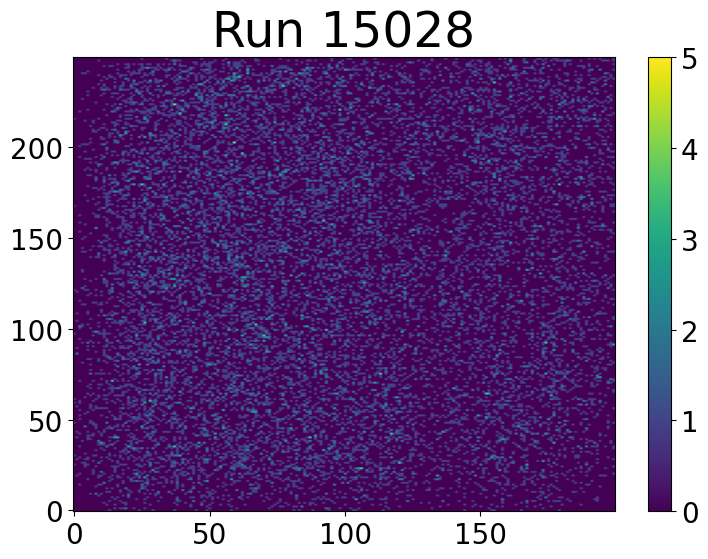

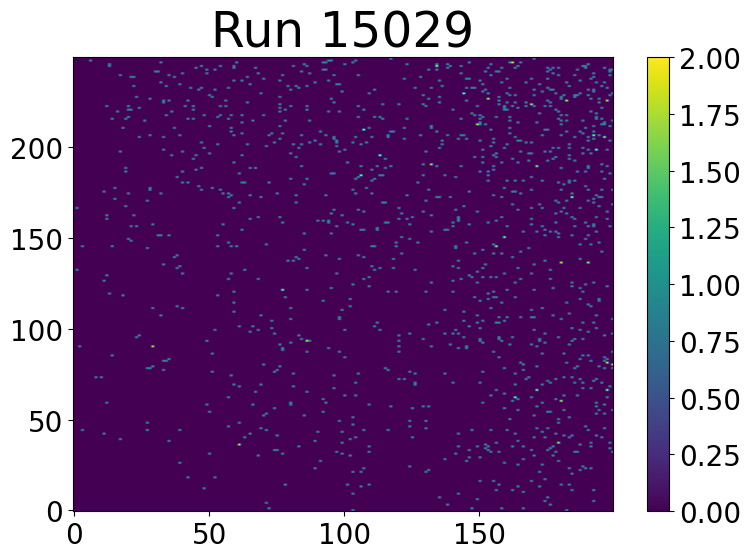

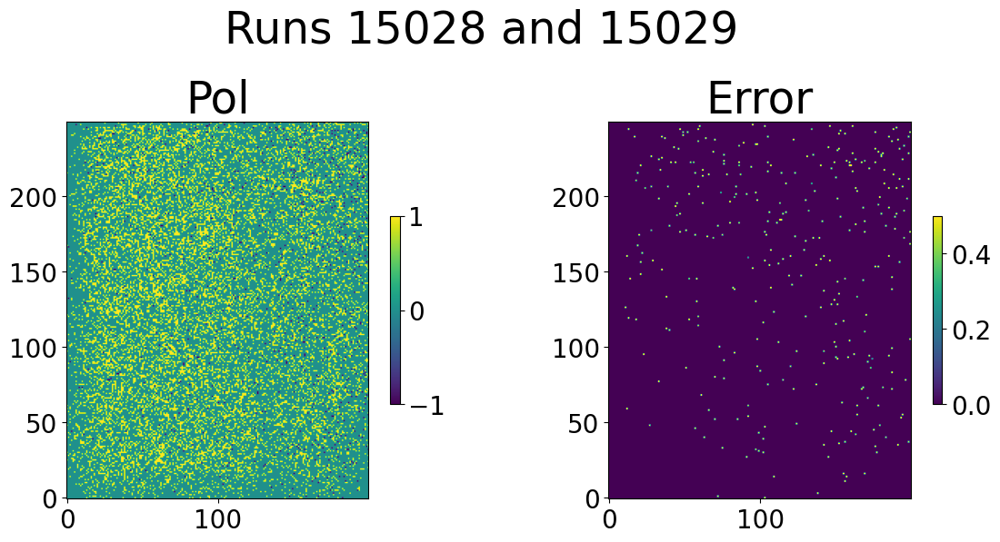

In [53]:
Rx,Ry = (180,380),(195,445)
center = int((Rx[1]+Rx[0])/2-Rx[0]),int((Ry[1]+Ry[0])/2-Ry[0])
up = fumi_reader(15028,direct=DEFAULT_DIRECT,ROI_x=Rx,ROI_y=Ry,plot=True)
down = fumi_reader(15029,direct=DEFAULT_DIRECT,ROI_x=Rx,ROI_y=Ry,plot=True)
_ = get_pol(up,down,zero=True,plot=True)

In [54]:
print(f'Whole beam FR: {round(np.sum(up[0])/np.sum(down[0]),1)}')
print(f'Average counts per pixel: {round(np.mean(up[0]),2)}')
print(f'Beam center pixel: {center}')
print(f'X pixel num: {Rx[1]-Rx[0]}')
print(f'Y pixel num: {Ry[1]-Ry[0]}')

Whole beam FR: 12.6
Average counts per pixel: 0.31
Beam center pixel: (100, 125)
X pixel num: 200
Y pixel num: 250


### 9/21 Cheeky lunch frequency scan

In [104]:
def reduce_scan(start,end,nu_scan=True,ROI_x=(100,400),ROI_y=(100,400),direct=DEFAULT_DIRECT,reb=False,\
               new_bins=(10,10),show_rebin=False):
    """Reduces scan to array of polarizations (or intensities) and errors.
    Doesn't include the end scan."""
    if nu_scan:
        ups = np.array([fumi_reader(i,direct=direct,ROI_x=ROI_x,ROI_y=ROI_y)[0] for i in range(start,start+7,1)])
        downs = np.array([fumi_reader(i,direct=direct,ROI_x=ROI_x,ROI_y=ROI_y)[0] for i in range(start+15,end,1)])
        if reb:
            ups = np.array([rebin(up,new_bins=new_bins,show_rebin=show_rebin) for up in ups])
            downs = np.array([rebin(down,new_bins=new_bins,show_rebin=show_rebin) for down in downs])
        pols = np.array([get_pol((up,start),(down,start))[0] for up,down in zip(ups,downs)])
    else:
        pass #to do
        #pol = np.sum([fumi_reader(i,direct=direct,ROI_x=ROI_x,ROI_y=ROI_y)[0] for i in range(start,end)],axis=0)   #not really a polarization
        #err = np.sqrt(pol)  #counting error
    return pols

Unbinned data:
Error calculation failed!


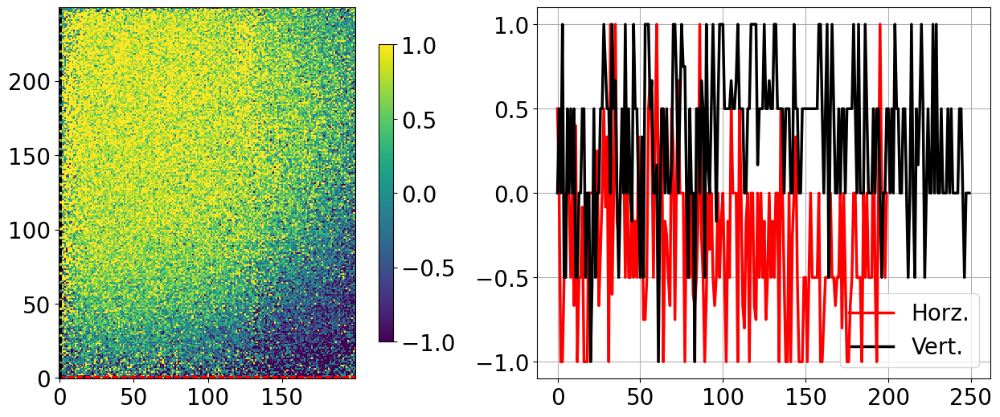

Error calculation failed!


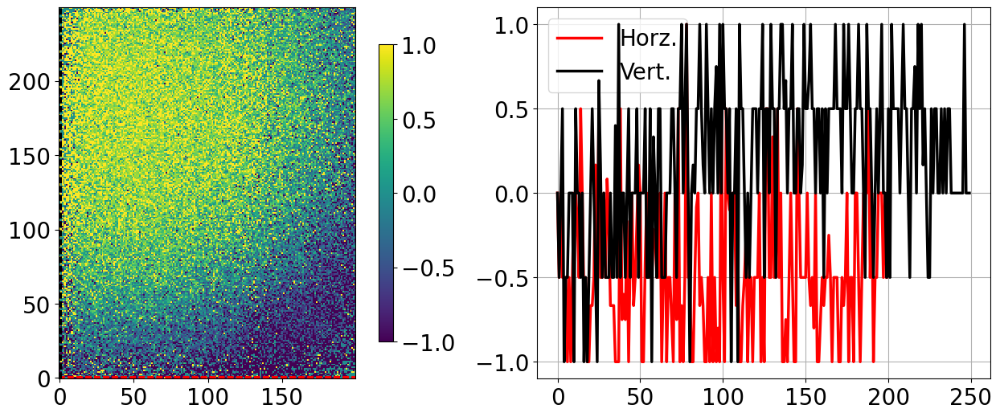

Error calculation failed!


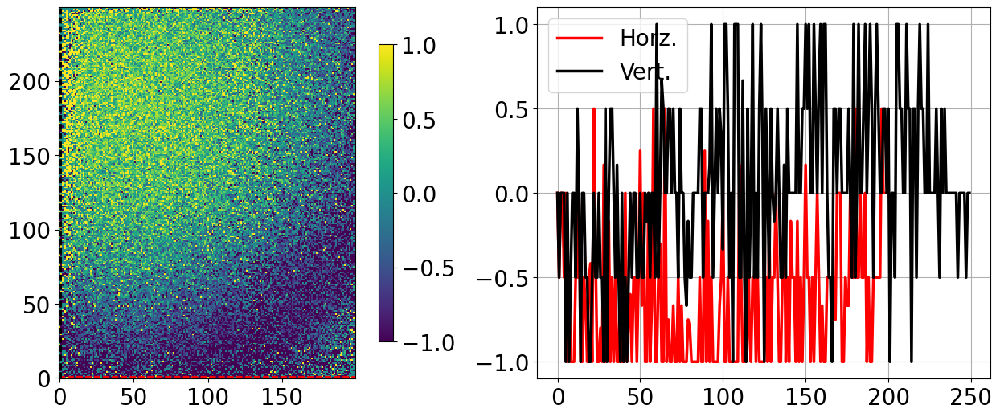

Error calculation failed!


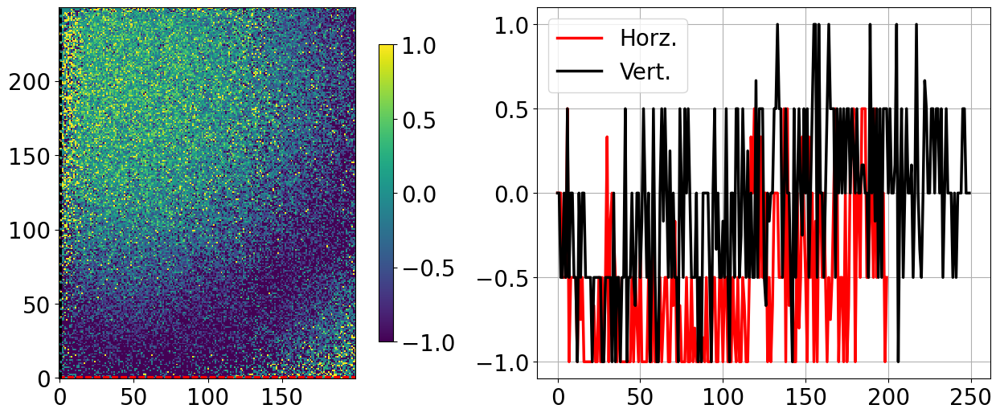

Error calculation failed!


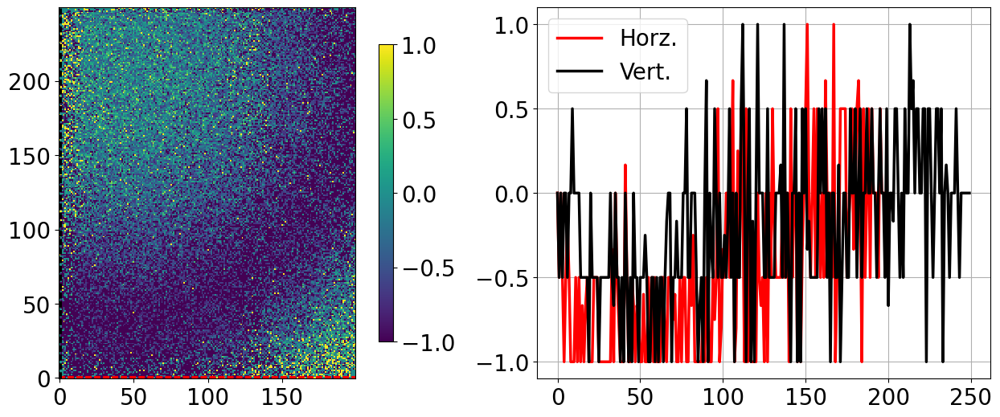

Error calculation failed!


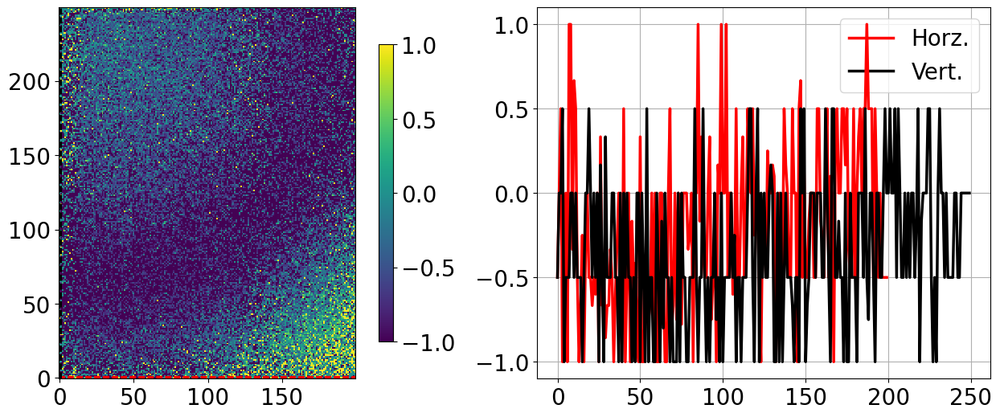

Error calculation failed!


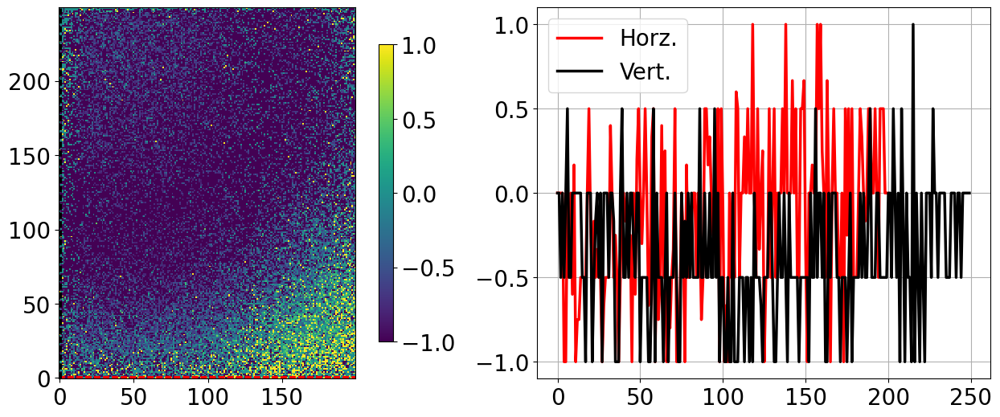

In [105]:
print(f'Unbinned data:')
pols = reduce_scan(15032,15054,nu_scan=True,ROI_x=Rx,ROI_y=Ry,reb=False)
_ = [cross(p,None,range(0,2),range(0,2),plot=True) for p in pols]

Unbinned data:
Error calculation failed!


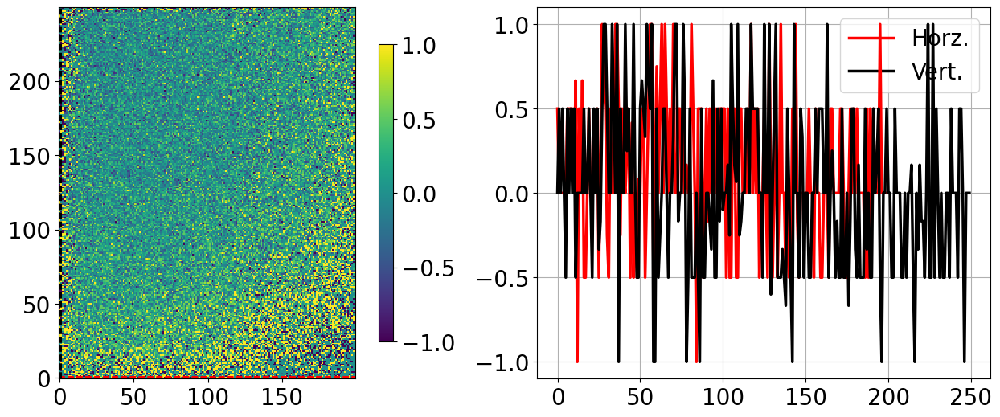

Binned data:
Error calculation failed!


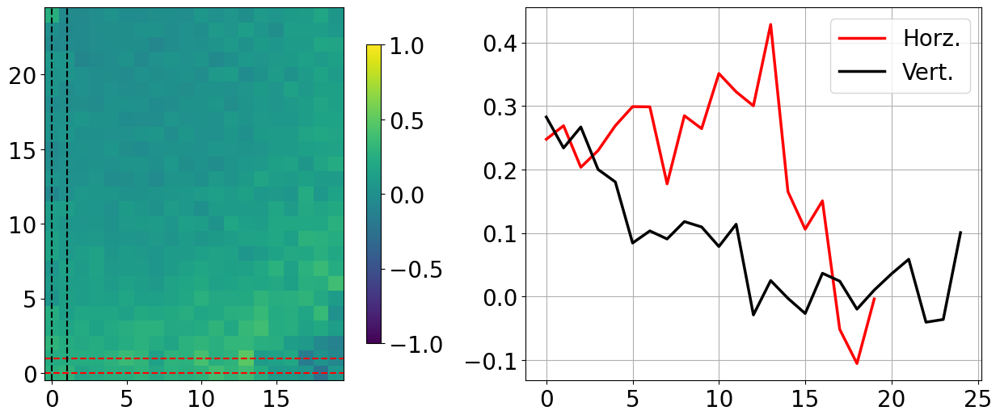

In [75]:
print(f'Binned data:')
pol2,_ = reduce_scan(15032,15044,nu_scan=True,ROI_x=Rx,ROI_y=Ry,reb=True,new_bins=(10,10))
_ = cross(pol2,None,range(0,2),range(0,2),plot=True)

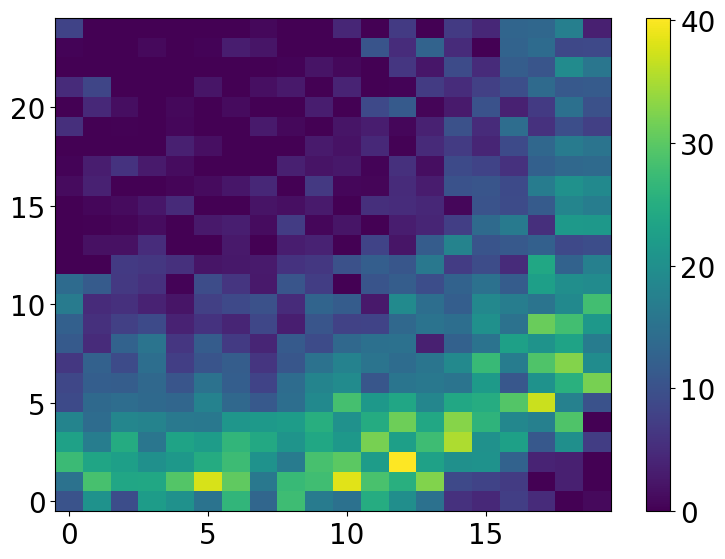

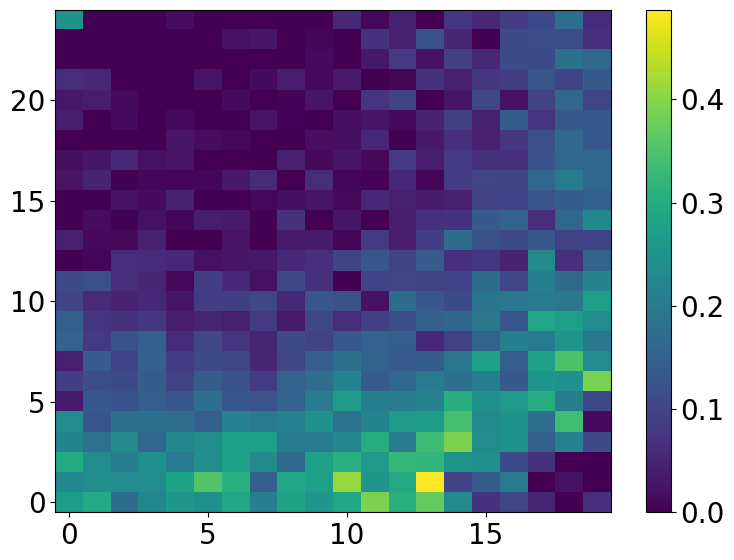

In [78]:
def rebin(image,new_bins=(1,1),show_rebin=True):
    """Rebins the 2D imaage.
    The new_bins parameter is the number of bins summed in x and y."""
    old_bins = np.shape(image)
    assert old_bins[0]%new_bins[0] == old_bins[1]%new_bins[1] == 0, f'New bin number {new_bins} must divide old bin number {old_bins}!'

    new = image.reshape(old_bins[0]//new_bins[0],new_bins[0],old_bins[1]//new_bins[1],new_bins[1]).sum(axis=(1,3))
    if show_rebin: _ = ShowImage(new)
    return new
_ = rebin(pol,new_bins=(10,10))
_ = rebin(pol2,new_bins=(1,1))

### 9/21 Quick alignment check

In [56]:
def reduce_scan(start,end,ROI_x=(100,400),ROI_y=(100,400),direct=DEFAULT_DIRECT,reb=False,\
               new_bins=(10,10),show_rebin=False):
    """Reduces scan to array of polarizations (or intensities) and errors.
    Doesn't include the end scan."""
    ups = np.array([fumi_reader(i,direct=direct,ROI_x=ROI_x,ROI_y=ROI_y)[0] for i in range(start,end,2)])
    downs = np.array([fumi_reader(i,direct=direct,ROI_x=ROI_x,ROI_y=ROI_y)[0] for i in range(start+1,end,2)])
    if reb:
        ups = np.array([rebin(up,new_bins=new_bins,show_rebin=show_rebin) for up in ups])
        downs = np.array([rebin(down,new_bins=new_bins,show_rebin=show_rebin) for down in downs])
    pols = np.array([get_pol((up,start),(down,start))[0] for up,down in zip(ups,downs)])
    return pols

def rebin(image,new_bins=(1,1),show_rebin=True):
    """Rebins the 2D imaage.
    The new_bins parameter is the number of bins summed in x and y."""
    old_bins = np.shape(image)
    assert old_bins[0]%new_bins[0] == old_bins[1]%new_bins[1] == 0, f'New bin number {new_bins} must divide old bin number {old_bins}!'

    new = image.reshape(old_bins[0]//new_bins[0],new_bins[0],old_bins[1]//new_bins[1],new_bins[1]).sum(axis=(1,3))
    if show_rebin: _ = ShowImage(new)
    return new

def fumi_reader(run_num,direct=DEFAULT_DIRECT,plot=False,ROI_x=(100,400),ROI_y=(100,400),print_run=False):
    """Reads and plots the csv datafile. Can specify a region of interest with ROI.
    Returns tuple of reduced data and run number."""
    filename = direct + f'Run_{run_num}_DSCALE_2_ROT_90.0.txt'
    if print_run: print(f'Run number used: {run_num}')
    assert isdir(direct), f'Data directory {direct} is not found!'
    assert isfile(filename), f'Datafile {filename} is not found!'
    
    with open(filename) as f:
        lines = csv.reader(f,delimiter=',')
        data = np.array([l for l in lines],dtype=float)[ROI_x[0]:ROI_x[1],ROI_y[0]:ROI_y[1]].T
    if plot: ShowImage(data,title=f'Run {run_num}')
    return data,run_num

def ShowImage(inImage,vmin=0,vmax=None,title=''):
    """Plots image in reduction function."""
    if vmax==None: vmax=np.max(inImage)
    fig, ax = plt.subplots(1,1,figsize=(8,6))
    ax.set_title(title)
    im = ax.imshow(inImage,origin="lower",aspect="auto",vmin=vmin,vmax=vmax)
    fig.colorbar(im)
    fig.tight_layout()
    plt.show()

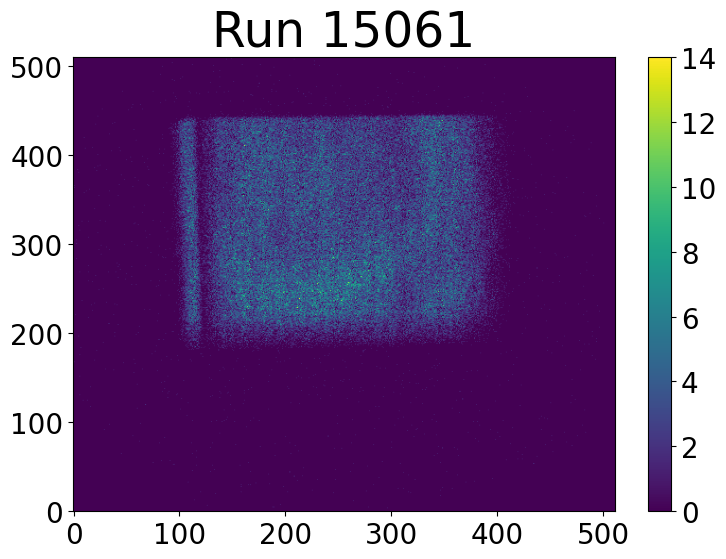

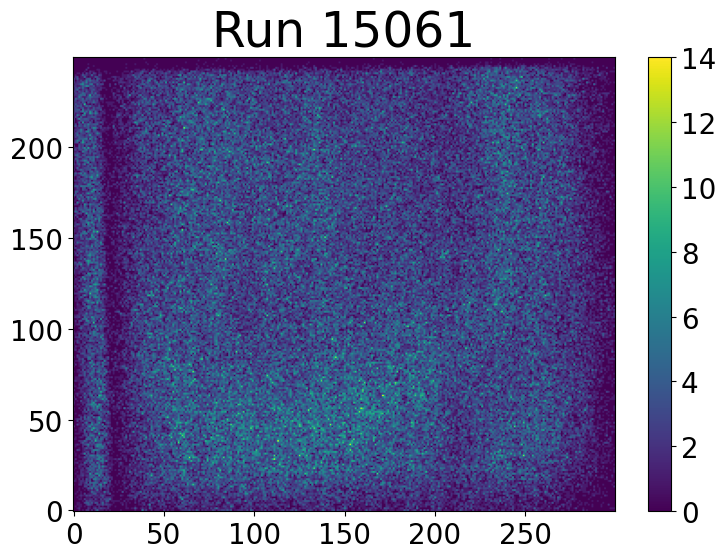

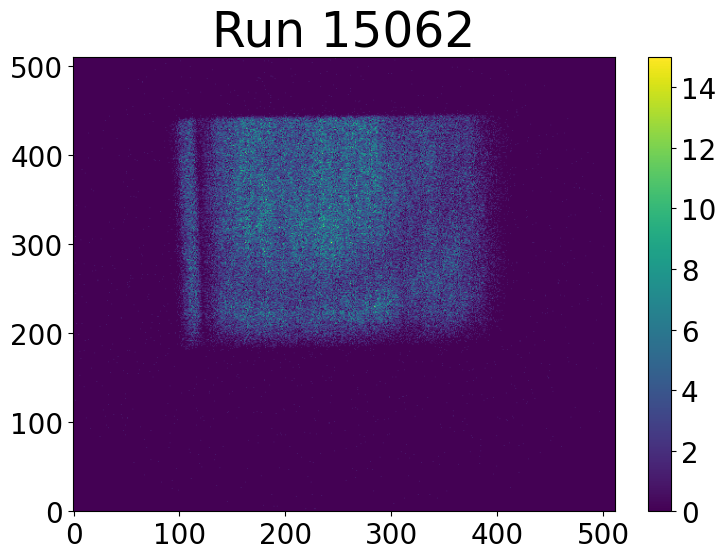

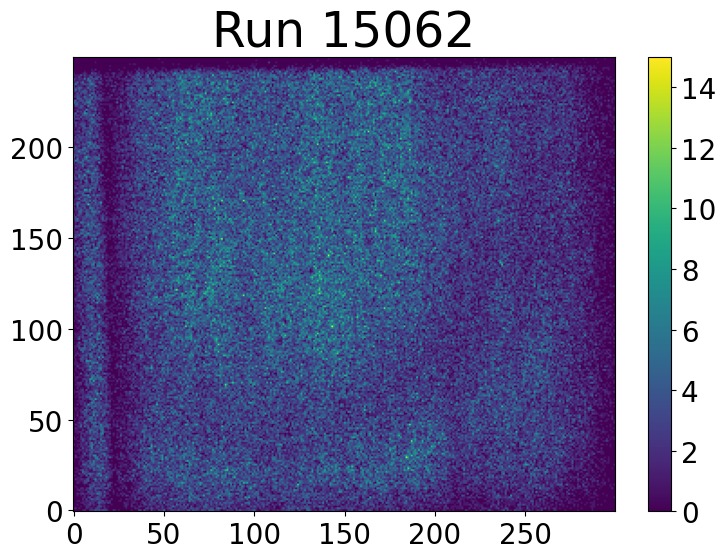

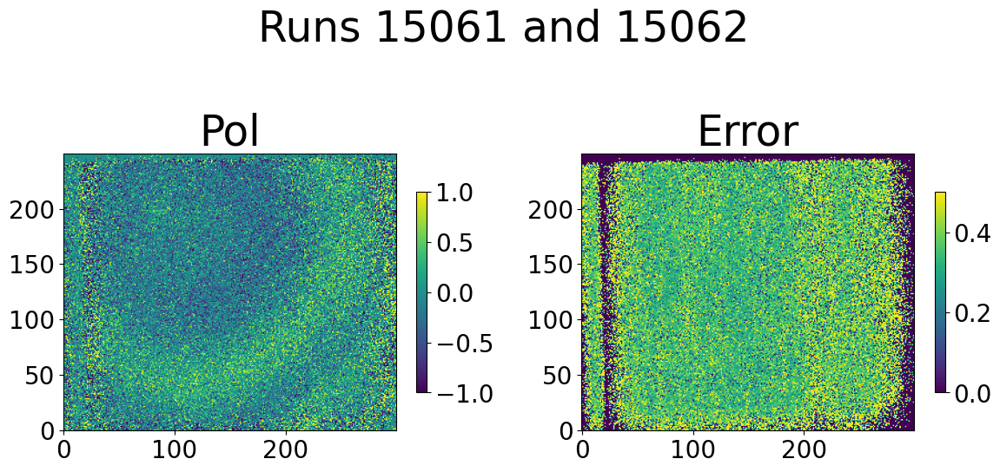

Whole beam FR: 0.9
Average counts per pixel: 2.7
Beam center pixel: (150, 125)
X pixel num: 300
Y pixel num: 250
Unbinned data:
Error calculation failed!


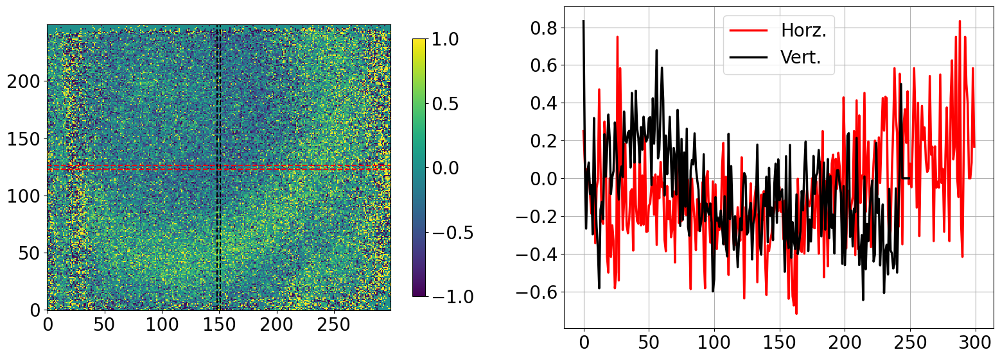

Binned data:
Error calculation failed!


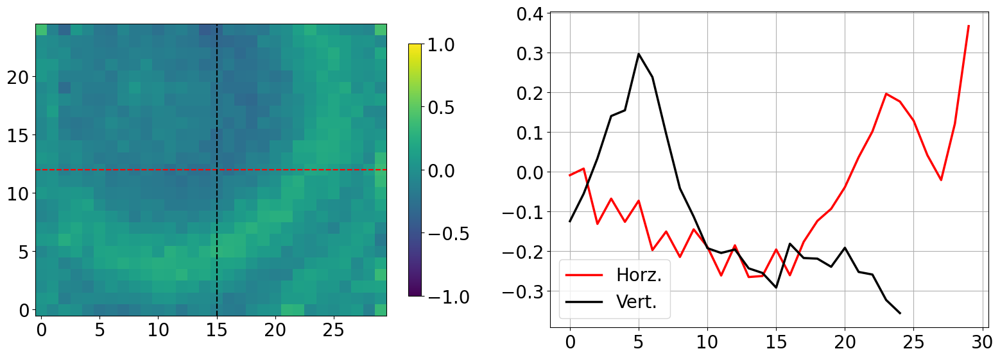

In [69]:
#before moving detector down
Rx,Ry = (100,400),(200,450)
center = int((Rx[1]+Rx[0])/2-Rx[0]),int((Ry[1]+Ry[0])/2-Ry[0])
up_all = fumi_reader(15061,direct=DEFAULT_DIRECT,ROI_x=(0,511),ROI_y=(0,511),plot=True)
up = fumi_reader(15061,direct=DEFAULT_DIRECT,ROI_x=Rx,ROI_y=Ry,plot=True)
down_all = fumi_reader(15062,direct=DEFAULT_DIRECT,ROI_x=(0,511),ROI_y=(0,511),plot=True)
down = fumi_reader(15062,direct=DEFAULT_DIRECT,ROI_x=Rx,ROI_y=Ry,plot=True)
_ = get_pol(up,down,zero=True,plot=True)
print(f'Whole beam FR: {round(np.sum(up[0])/np.sum(down[0]),1)}')
print(f'Average counts per pixel: {round(np.mean(up[0]),2)}')
print(f'Beam center pixel: {center}')
print(f'X pixel num: {Rx[1]-Rx[0]}')
print(f'Y pixel num: {Ry[1]-Ry[0]}')

print(f'Unbinned data:')
pols = reduce_scan(15061,15063,ROI_x=Rx,ROI_y=Ry,reb=False)
_ = [cross(p,None,range(center[0]-2,center[0]+2),range(center[1]-2,center[1]+2),plot=True) for p in pols]

print(f'Binned data:')
pols2 = reduce_scan(15061,15063,ROI_x=Rx,ROI_y=Ry,reb=True)
_ = [cross(p,None,range(center[0]//10,center[0]//10+1),range(center[1]//10,center[1]//10+1),plot=True) for p in pols2]

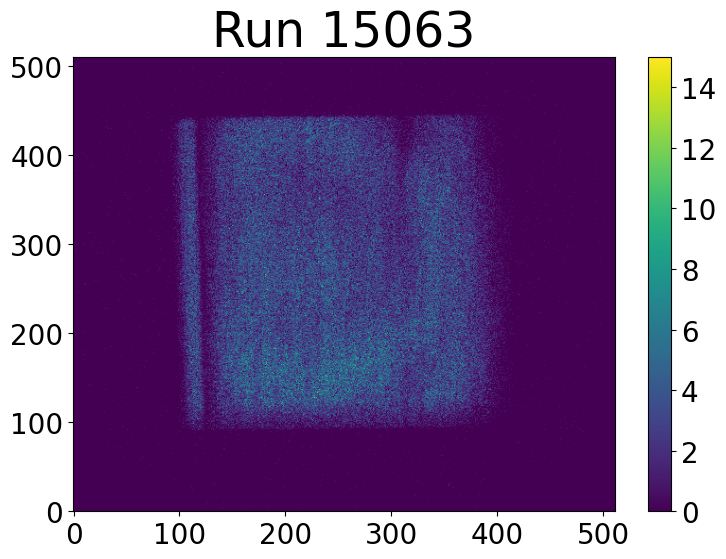

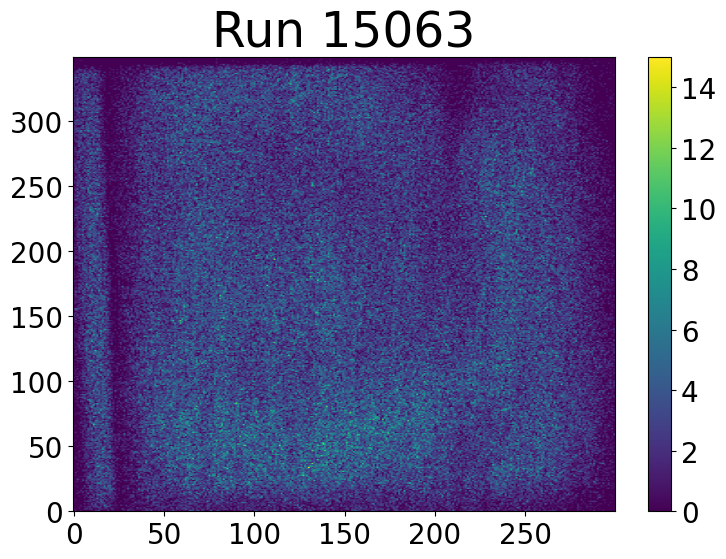

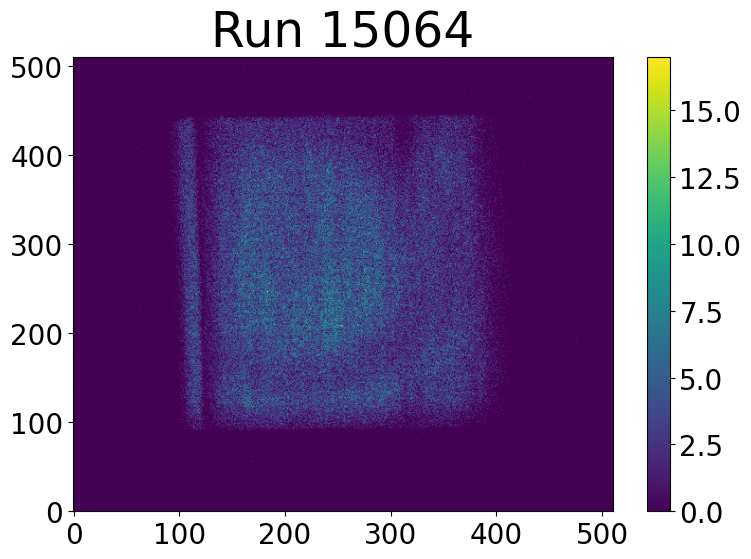

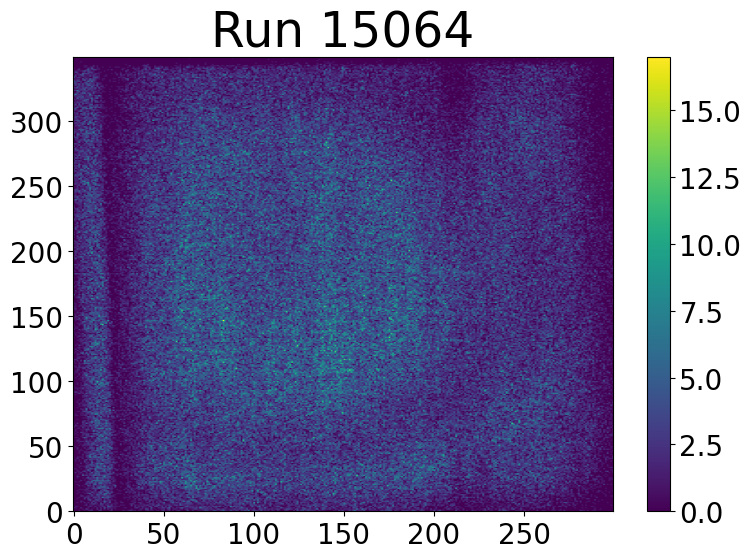

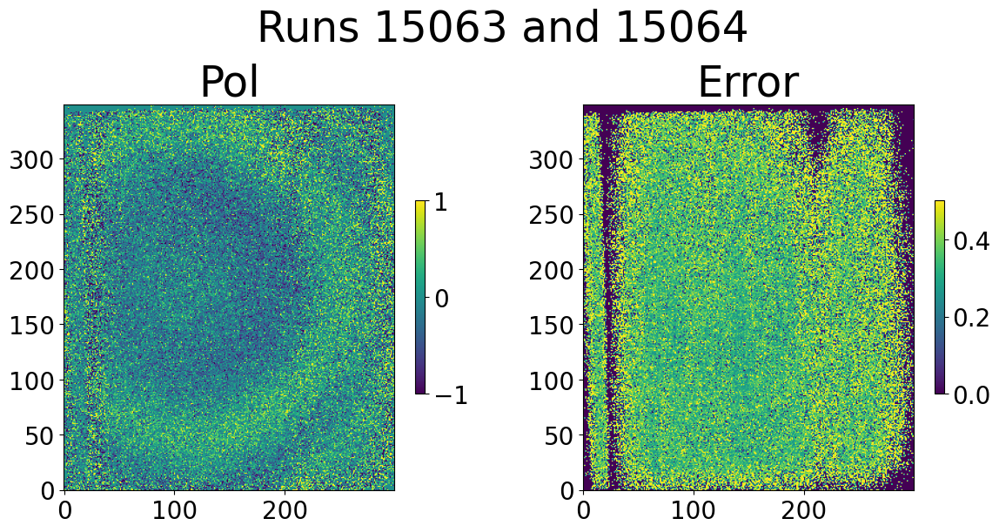

Whole beam FR: 0.9
Average counts per pixel: 2.54
Beam center pixel: (150, 175)
X pixel num: 300
Y pixel num: 350
Unbinned data:
Error calculation failed!


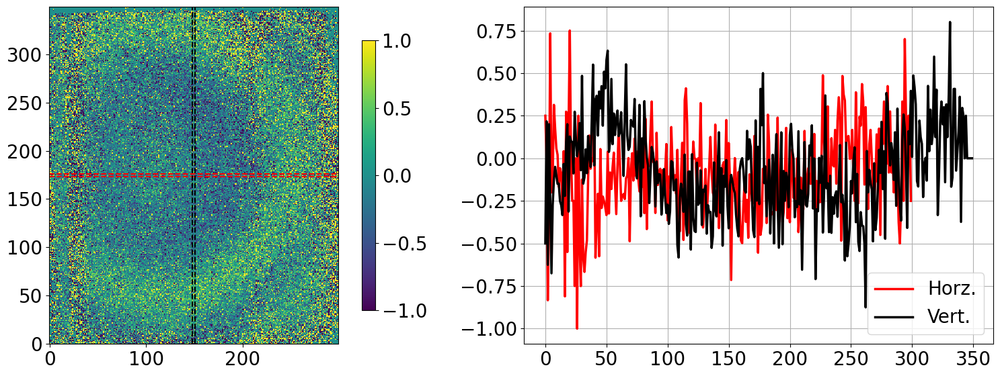

Binned data:
Error calculation failed!


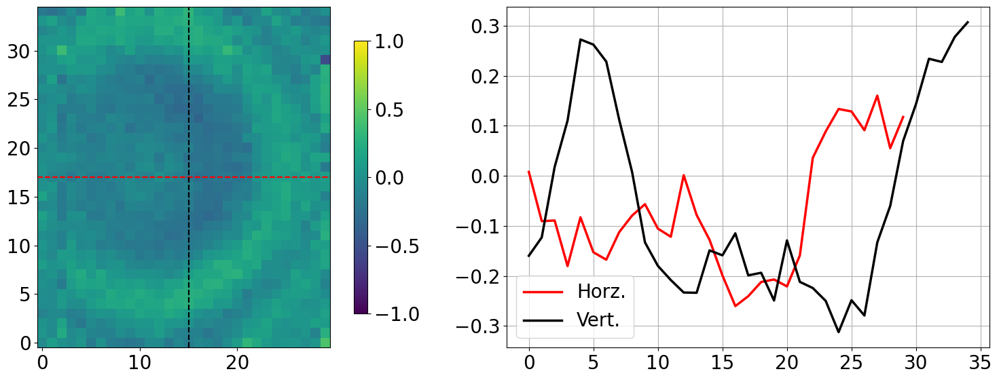

In [59]:
#after moving the detector vertically
Rx,Ry = (100,400),(100,450)
center = int((Rx[1]+Rx[0])/2-Rx[0]),int((Ry[1]+Ry[0])/2-Ry[0])
up_all = fumi_reader(15063,direct=DEFAULT_DIRECT,ROI_x=(0,511),ROI_y=(0,511),plot=True)
up = fumi_reader(15063,direct=DEFAULT_DIRECT,ROI_x=Rx,ROI_y=Ry,plot=True)
down_all = fumi_reader(15064,direct=DEFAULT_DIRECT,ROI_x=(0,511),ROI_y=(0,511),plot=True)
down = fumi_reader(15064,direct=DEFAULT_DIRECT,ROI_x=Rx,ROI_y=Ry,plot=True)
_ = get_pol(up,down,zero=True,plot=True)
print(f'Whole beam FR: {round(np.sum(up[0])/np.sum(down[0]),1)}')
print(f'Average counts per pixel: {round(np.mean(up[0]),2)}')
print(f'Beam center pixel: {center}')
print(f'X pixel num: {Rx[1]-Rx[0]}')
print(f'Y pixel num: {Ry[1]-Ry[0]}')

print(f'Unbinned data:')
pols = reduce_scan(15063,15065,ROI_x=Rx,ROI_y=Ry,reb=False)
_ = [cross(p,None,range(center[0]-2,center[0]+2),range(center[1]-2,center[1]+2),plot=True) for p in pols]

print(f'Binned data:')
pols2 = reduce_scan(15063,15065,ROI_x=Rx,ROI_y=Ry,reb=True)
_ = [cross(p,None,range(center[0]//10,center[0]//10+1),range(center[1]//10,center[1]//10+1),plot=True) for p in pols2]

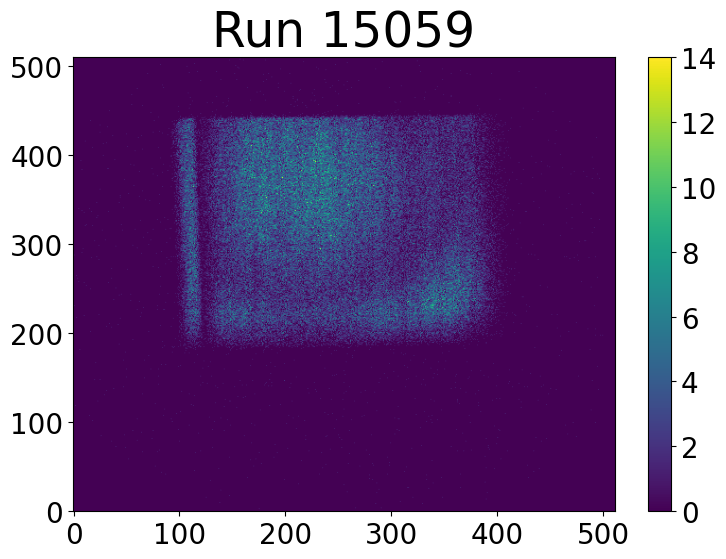

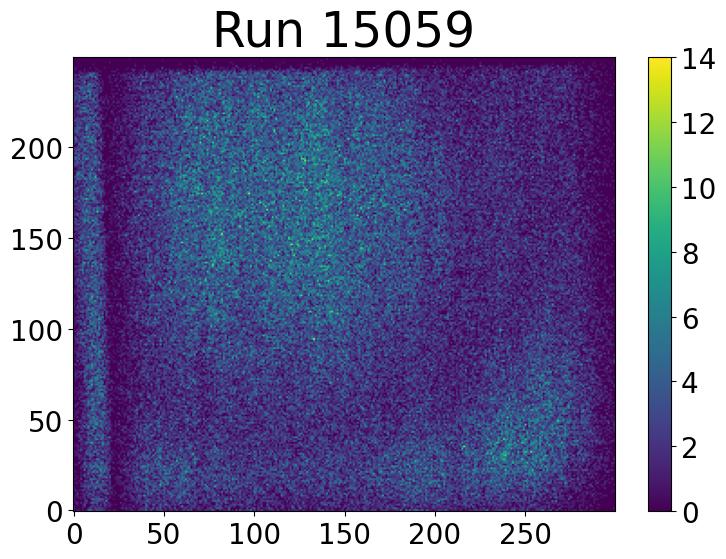

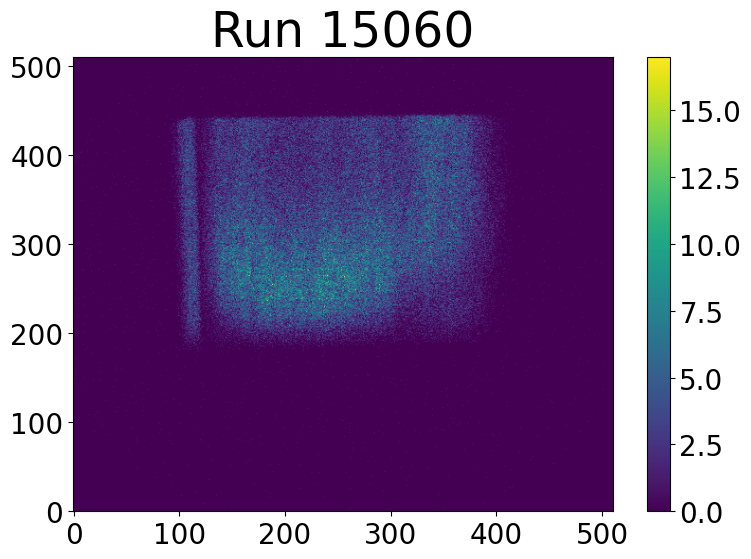

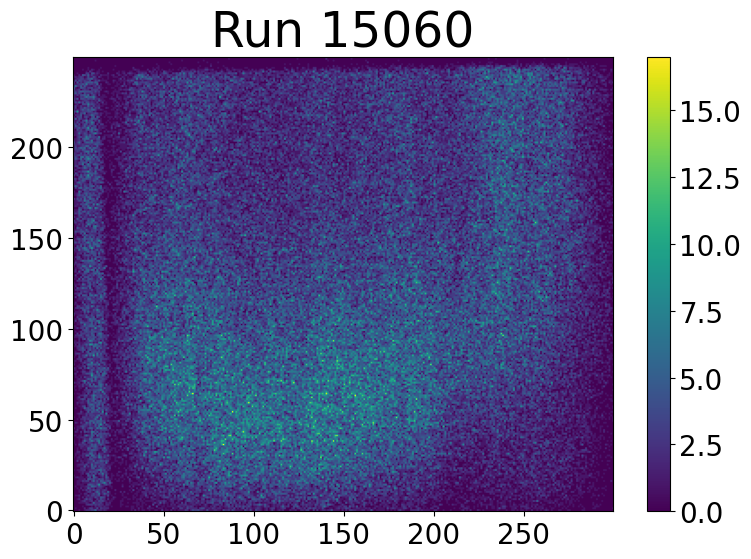

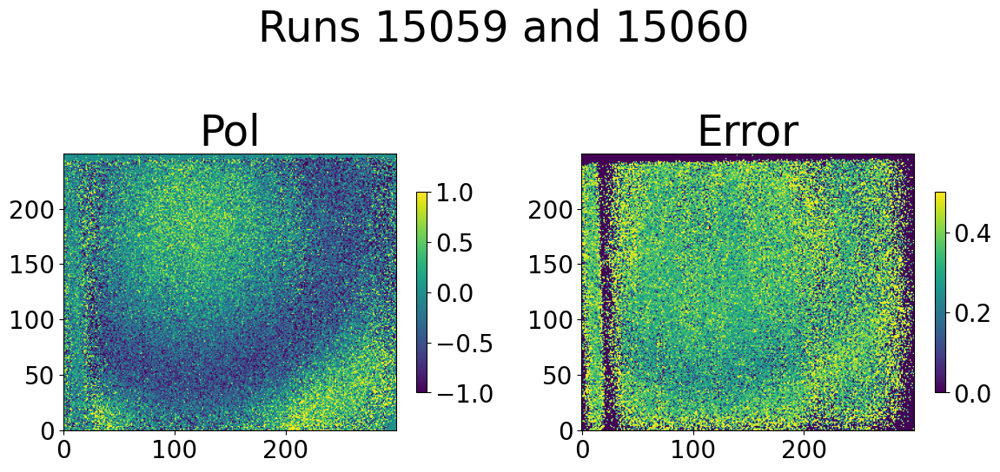

Whole beam FR: 0.8
Average counts per pixel: 2.43
Beam center pixel: (150, 125)
X pixel num: 300
Y pixel num: 250
Unbinned data:
Error calculation failed!


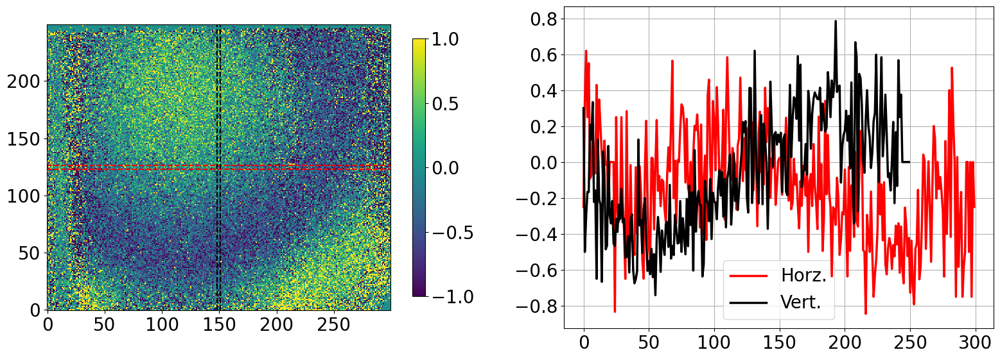

Binned data:
Error calculation failed!


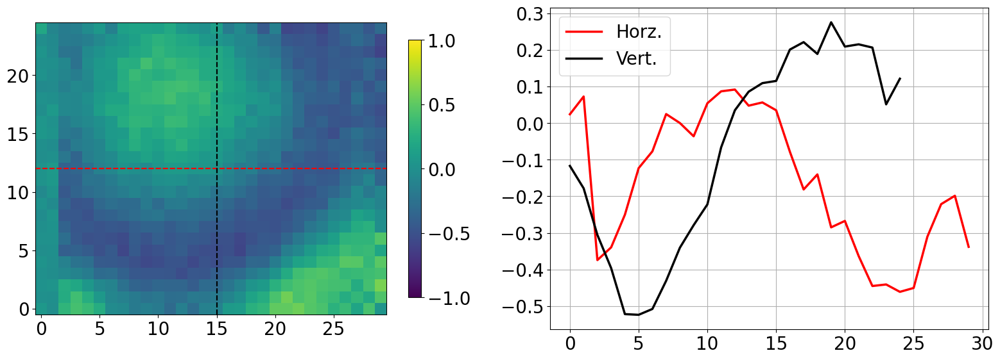

In [66]:
#After remvoing the mirabor
Rx,Ry = (100,400),(200,450)
center = int((Rx[1]+Rx[0])/2-Rx[0]),int((Ry[1]+Ry[0])/2-Ry[0])
up_all = fumi_reader(15059,direct=DEFAULT_DIRECT,ROI_x=(0,511),ROI_y=(0,511),plot=True)
up = fumi_reader(15059,direct=DEFAULT_DIRECT,ROI_x=Rx,ROI_y=Ry,plot=True)
down_all = fumi_reader(15060,direct=DEFAULT_DIRECT,ROI_x=(0,511),ROI_y=(0,511),plot=True)
down = fumi_reader(15060,direct=DEFAULT_DIRECT,ROI_x=Rx,ROI_y=Ry,plot=True)
_ = get_pol(up,down,zero=True,plot=True)
print(f'Whole beam FR: {round(np.sum(up[0])/np.sum(down[0]),1)}')
print(f'Average counts per pixel: {round(np.mean(up[0]),2)}')
print(f'Beam center pixel: {center}')
print(f'X pixel num: {Rx[1]-Rx[0]}')
print(f'Y pixel num: {Ry[1]-Ry[0]}')

print(f'Unbinned data:')
pols = reduce_scan(15059,15061,ROI_x=Rx,ROI_y=Ry,reb=False)
_ = [cross(p,None,range(center[0]-2,center[0]+2),range(center[1]-2,center[1]+2),plot=True) for p in pols]

print(f'Binned data:')
pols2 = reduce_scan(15059,15061,ROI_x=Rx,ROI_y=Ry,reb=True)
_ = [cross(p,None,range(center[0]//10,center[0]//10+1),range(center[1]//10,center[1]//10+1),plot=True) for p in pols2]

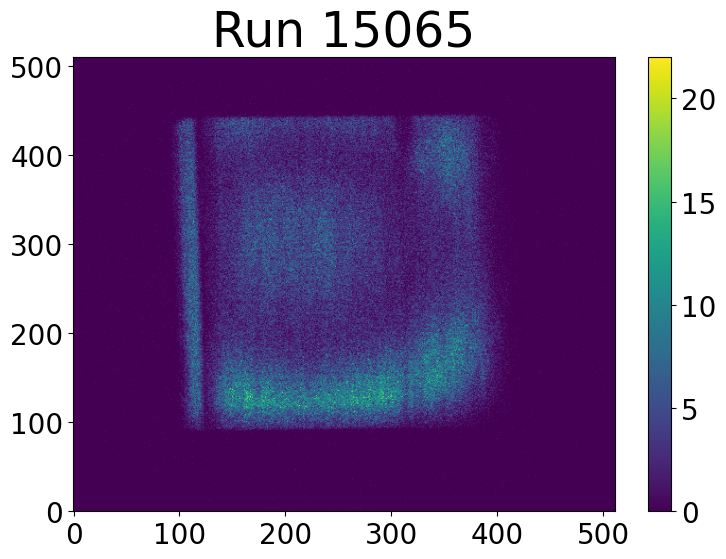

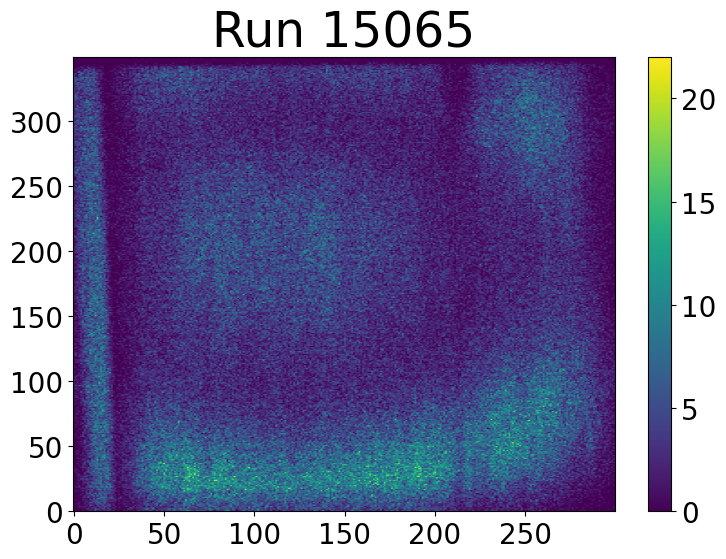

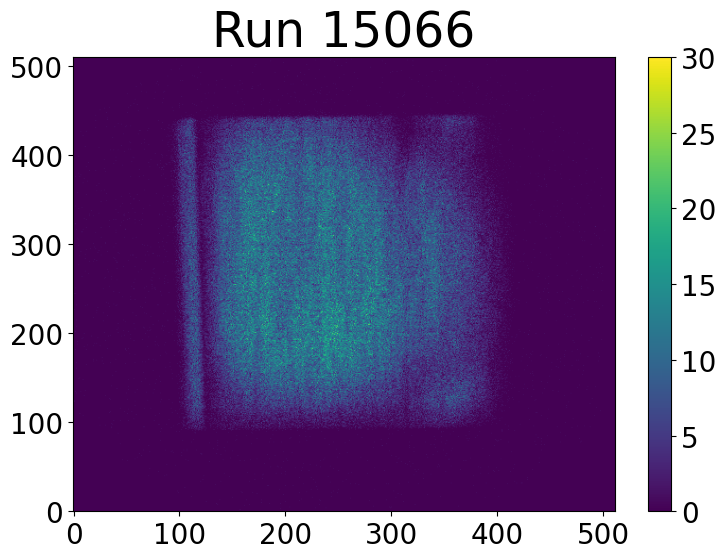

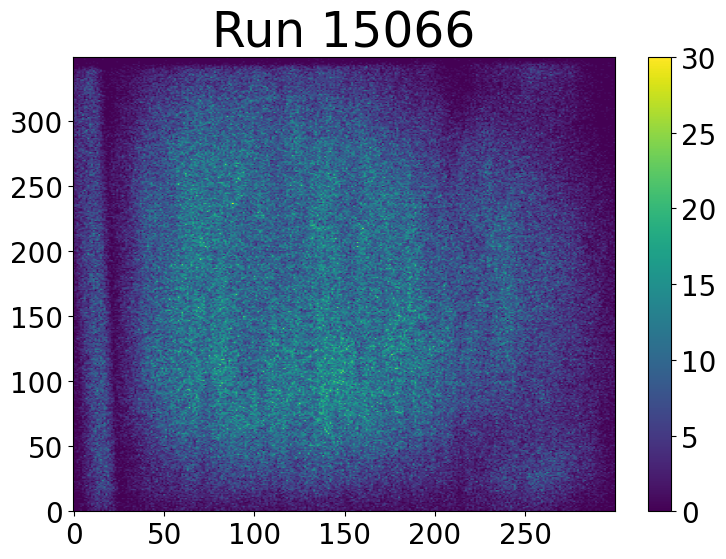

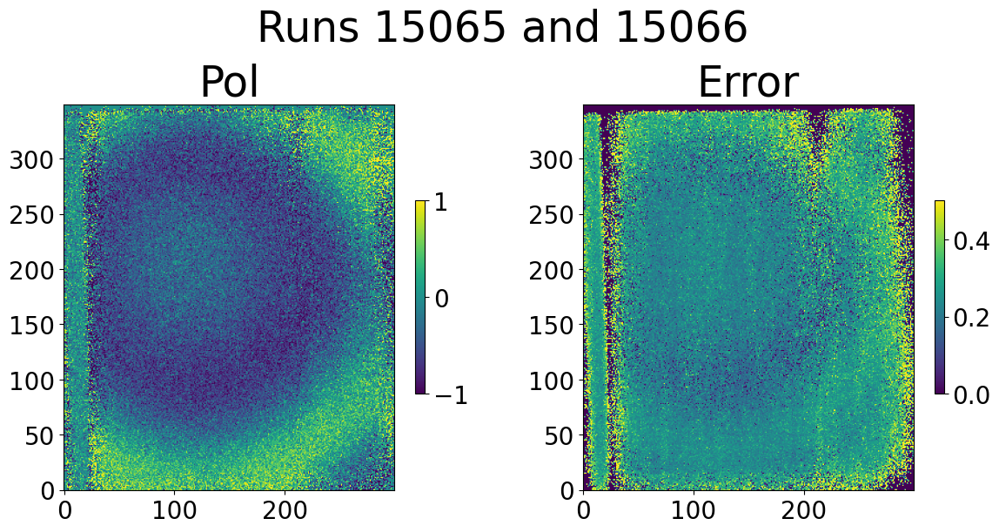

Whole beam FR: 0.6
Average counts per pixel: 3.71
Beam center pixel: (150, 175)
X pixel num: 300
Y pixel num: 350
Unbinned data:
Error calculation failed!


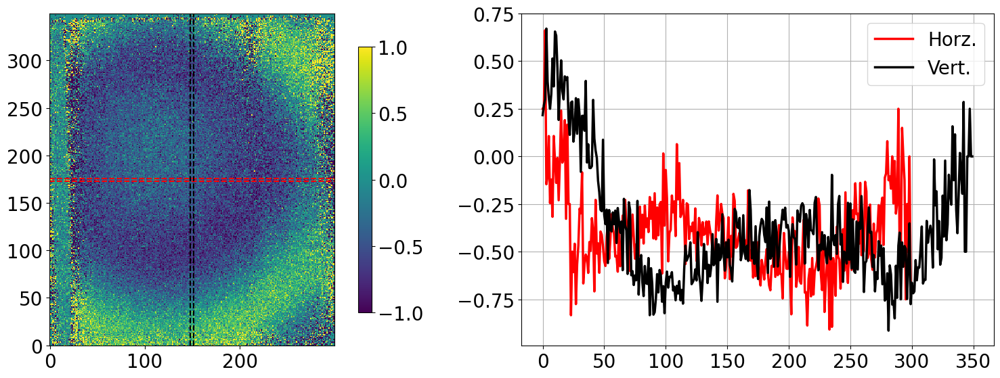

Binned data:
Error calculation failed!


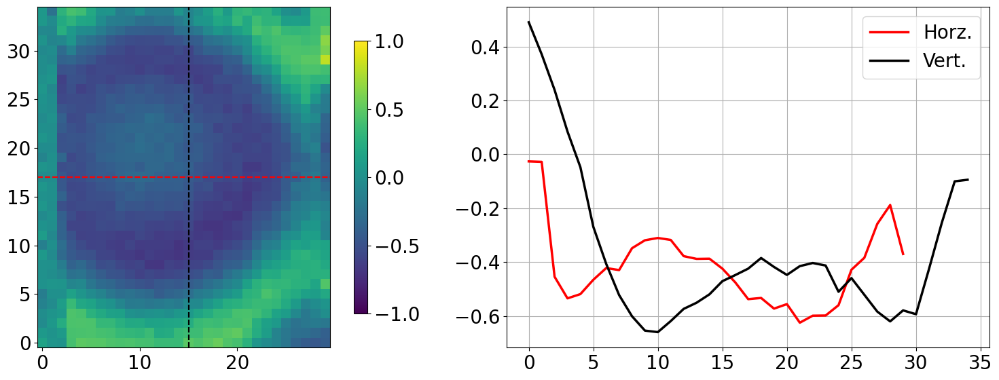

In [140]:
#after degauss,back to 10 amps
Rx,Ry = (100,400),(100,450)
center = int((Rx[1]+Rx[0])/2-Rx[0]),int((Ry[1]+Ry[0])/2-Ry[0])
up_all = fumi_reader(15065,direct=DEFAULT_DIRECT,ROI_x=(0,511),ROI_y=(0,511),plot=True)
up = fumi_reader(15065,direct=DEFAULT_DIRECT,ROI_x=Rx,ROI_y=Ry,plot=True)
down_all = fumi_reader(15066,direct=DEFAULT_DIRECT,ROI_x=(0,511),ROI_y=(0,511),plot=True)
down = fumi_reader(15066,direct=DEFAULT_DIRECT,ROI_x=Rx,ROI_y=Ry,plot=True)
_ = get_pol(up,down,zero=True,plot=True)
print(f'Whole beam FR: {round(np.sum(up[0])/np.sum(down[0]),1)}')
print(f'Average counts per pixel: {round(np.mean(up[0]),2)}')
print(f'Beam center pixel: {center}')
print(f'X pixel num: {Rx[1]-Rx[0]}')
print(f'Y pixel num: {Ry[1]-Ry[0]}')

print(f'Unbinned data:')
pols = reduce_scan(15065,15067,ROI_x=Rx,ROI_y=Ry,reb=False)
_ = [cross(p,None,range(center[0]-2,center[0]+2),range(center[1]-2,center[1]+2),plot=True) for p in pols]

print(f'Binned data:')
pols2 = reduce_scan(15065,15067,ROI_x=Rx,ROI_y=Ry,reb=True)
_ = [cross(p,None,range(center[0]//10,center[0]//10+1),range(center[1]//10,center[1]//10+1),plot=True) for p in pols2]

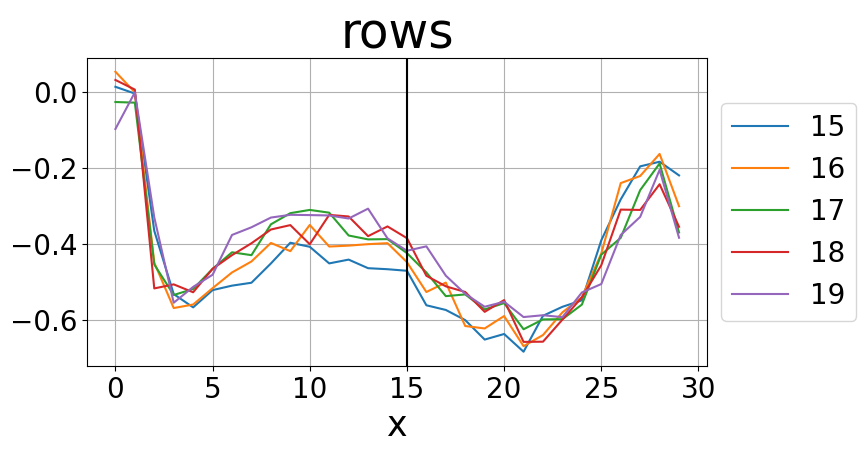

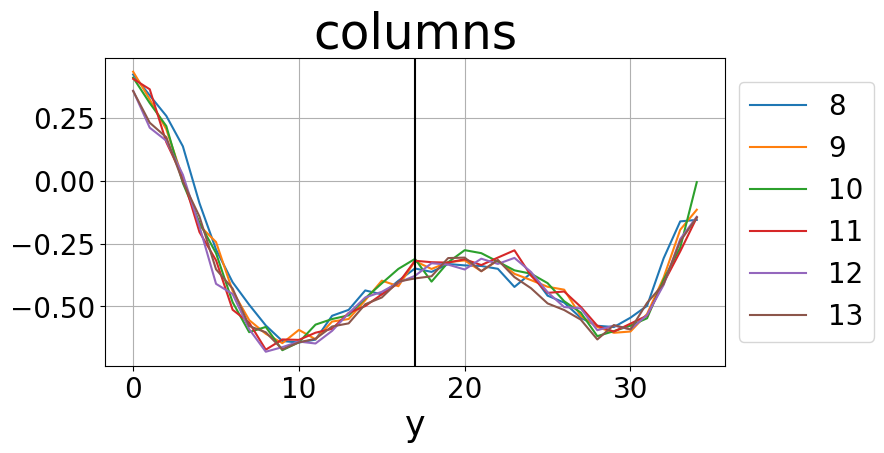

In [141]:
plt.figure(figsize=(8,4))
plt.title('rows')
for i in range(15,20):
    #plt.plot(range(3,23),pols2[0,i,3:-6],'-',label=f'{i}')
    plt.plot(pols2[0,i,:],'-',label=f'{i}')
plt.xlabel('x')
plt.axvline(x=center[0]//10,color='black')
ax = plt.gca()
ax.legend(loc='center left',bbox_to_anchor=(1,0.5))
plt.grid()
plt.show()

plt.figure(figsize=(8,4)) 
plt.title('columns')
for i in range(8,14):
    #plt.plot(range(5,27),pols2[0,5:-8,i],'-',label=f'{i}')
    plt.plot(pols2[0,:,i],'-',label=f'{i}')
plt.xlabel('y')
plt.axvline(x=center[1]//10,color='black')
ax = plt.gca()
ax.legend(loc='center left',bbox_to_anchor=(1,0.5))
plt.grid()
plt.show()

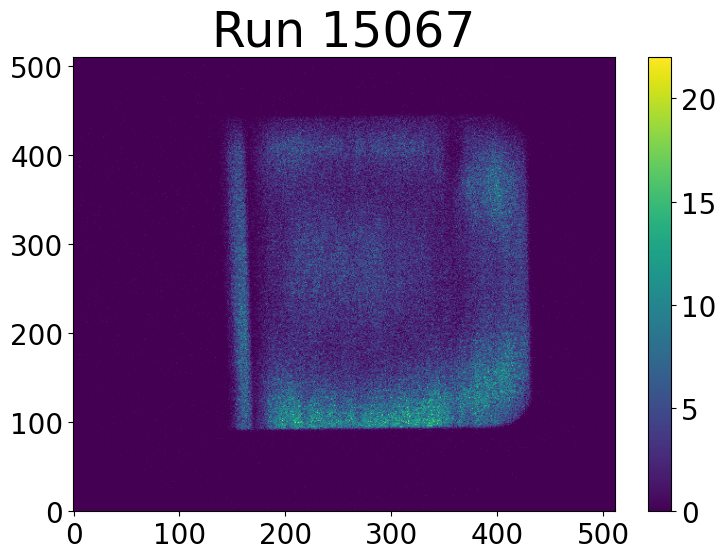

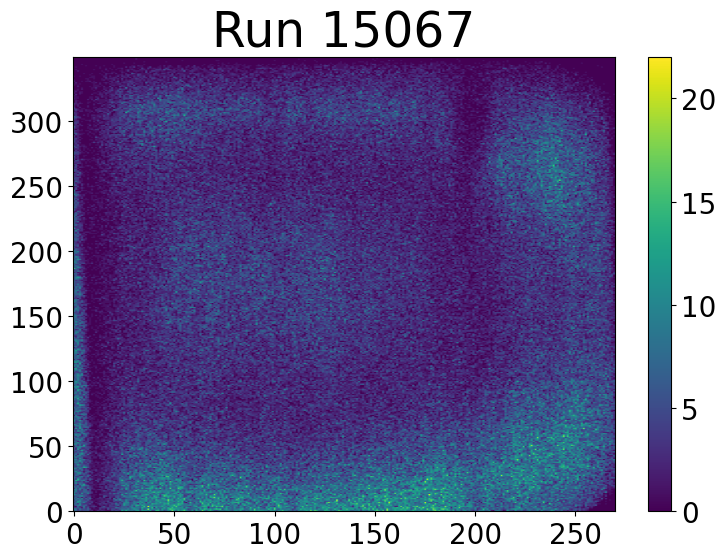

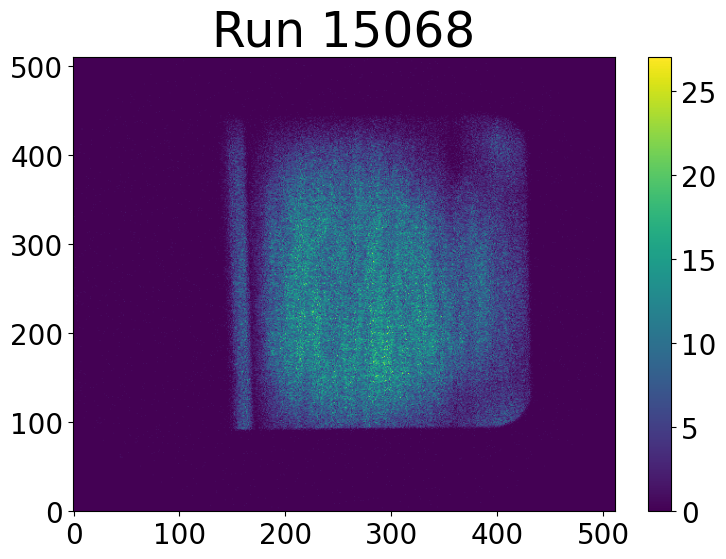

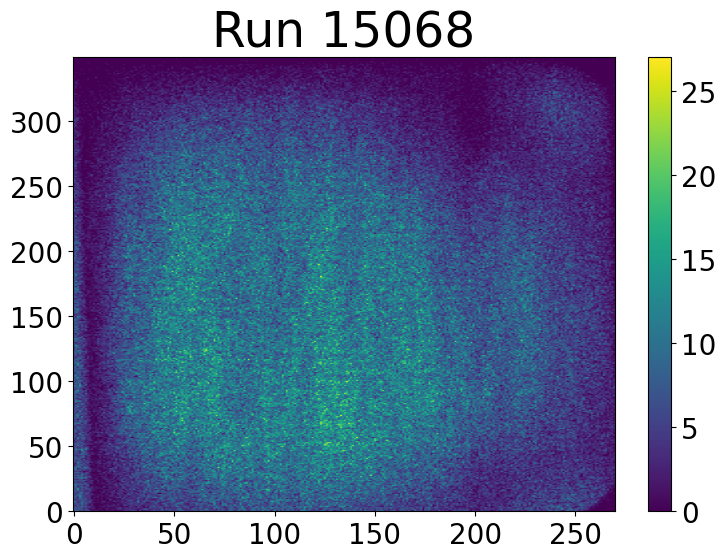

Whole beam FR: 0.5
Average counts per pixel: 3.55
Beam center pixel: (135, 175)
X pixel num: 270
Y pixel num: 350
Binned data:
Error calculation failed!


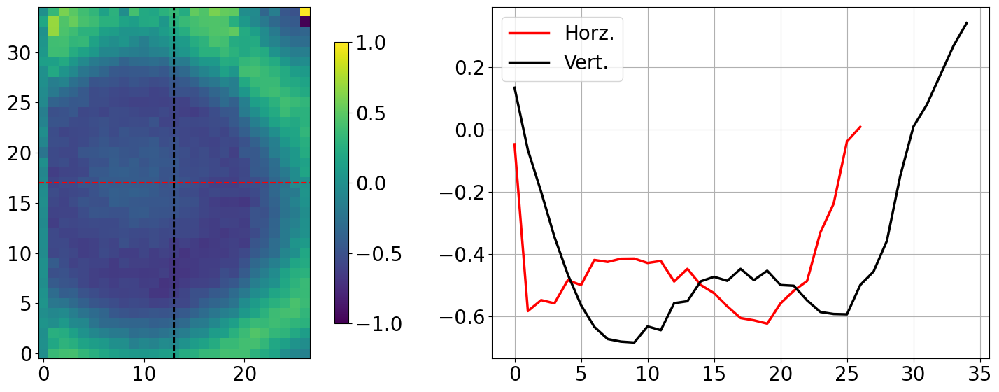

In [149]:
#recentering the detector vertically and horiztonally
Rx,Ry = (160,430),(100,450)
center = int((Rx[1]+Rx[0])/2-Rx[0]),int((Ry[1]+Ry[0])/2-Ry[0])
up_all = fumi_reader(15067,direct=DEFAULT_DIRECT,ROI_x=(0,511),ROI_y=(0,511),plot=True)
up = fumi_reader(15067,direct=DEFAULT_DIRECT,ROI_x=Rx,ROI_y=Ry,plot=True)
down_all = fumi_reader(15068,direct=DEFAULT_DIRECT,ROI_x=(0,511),ROI_y=(0,511),plot=True)
down = fumi_reader(15068,direct=DEFAULT_DIRECT,ROI_x=Rx,ROI_y=Ry,plot=True)
#_ = get_pol(up,down,zero=True,plot=True)
print(f'Whole beam FR: {round(np.sum(up[0])/np.sum(down[0]),1)}')
print(f'Average counts per pixel: {round(np.mean(up[0]),2)}')
print(f'Beam center pixel: {center}')
print(f'X pixel num: {Rx[1]-Rx[0]}')
print(f'Y pixel num: {Ry[1]-Ry[0]}')

#print(f'Unbinned data:')
#pols = reduce_scan(15067,15069,ROI_x=Rx,ROI_y=Ry,reb=False)
#_ = [cross(p,None,range(center[0]-2,center[0]+2),range(center[1]-2,center[1]+2),plot=True) for p in pols]

print(f'Binned data:')
pols2 = reduce_scan(15067,15069,ROI_x=Rx,ROI_y=Ry,reb=True)
_ = [cross(p,None,range(center[0]//10,center[0]//10+1),range(center[1]//10,center[1]//10+1),plot=True) for p in pols2]

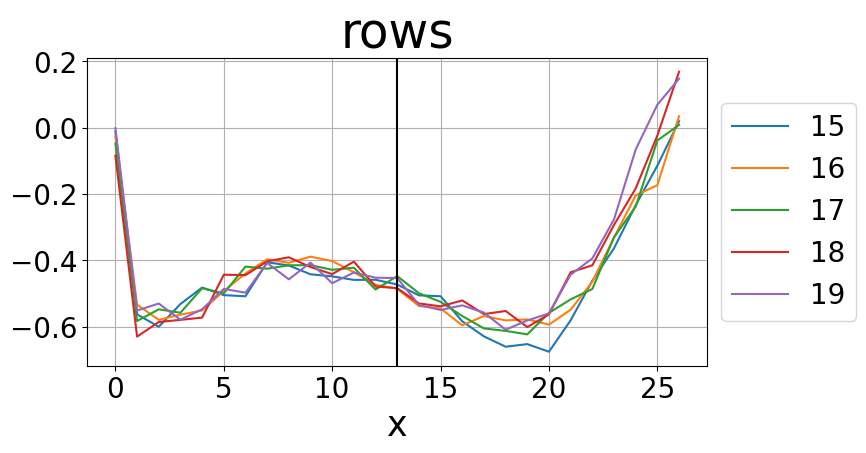

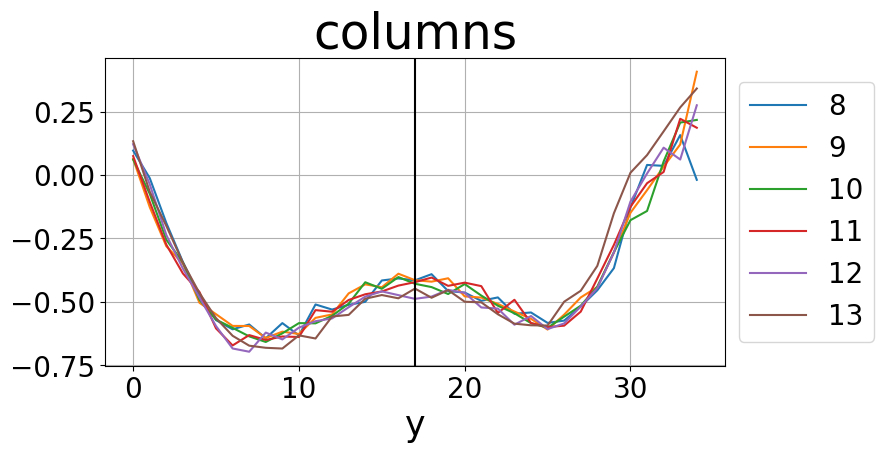

In [150]:
plt.figure(figsize=(8,4))
plt.title('rows')
for i in range(15,20):
    #plt.plot(range(3,23),pols2[0,i,3:-6],'-',label=f'{i}')
    plt.plot(pols2[0,i,:],'-',label=f'{i}')
plt.xlabel('x')
plt.axvline(x=center[0]//10,color='black')
ax = plt.gca()
ax.legend(loc='center left',bbox_to_anchor=(1,0.5))
plt.grid()
plt.show()

plt.figure(figsize=(8,4)) 
plt.title('columns')
for i in range(8,14):
    #plt.plot(range(5,27),pols2[0,5:-8,i],'-',label=f'{i}')
    plt.plot(pols2[0,:,i],'-',label=f'{i}')
plt.xlabel('y')
plt.axvline(x=center[1]//10,color='black')
ax = plt.gca()
ax.legend(loc='center left',bbox_to_anchor=(1,0.5))
plt.grid()
plt.show()

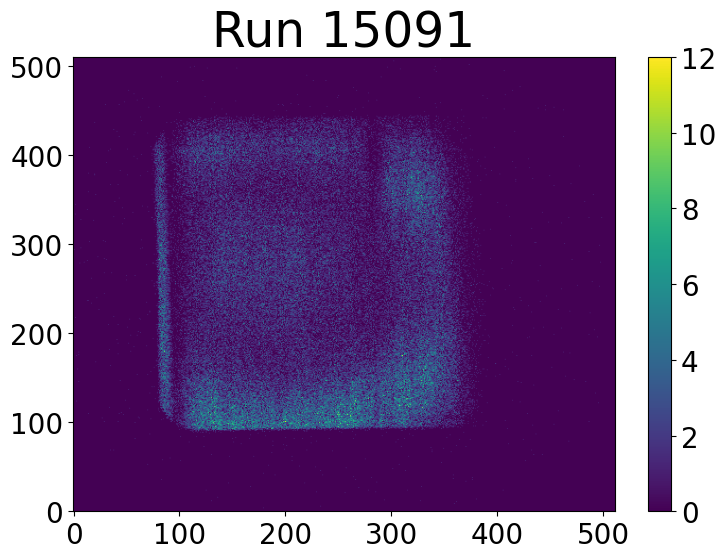

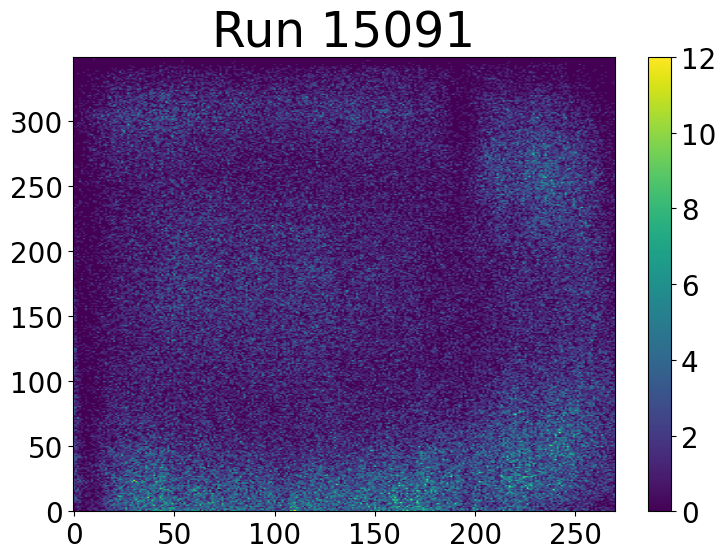

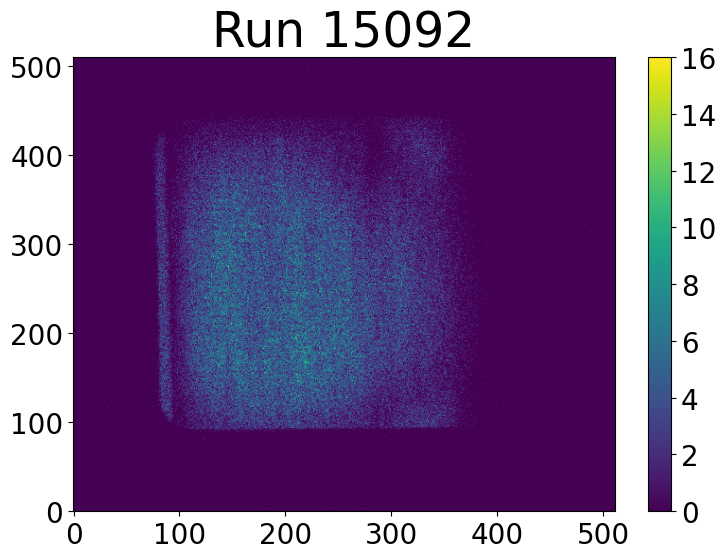

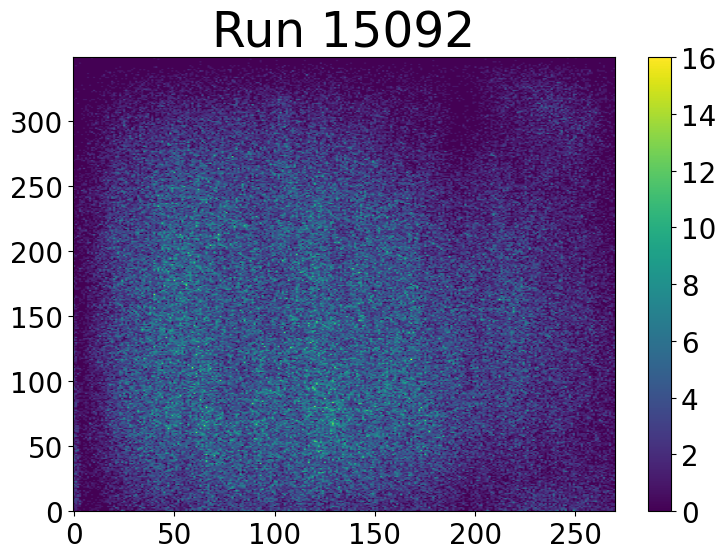

Whole beam FR: 0.5
Average counts per pixel: 1.4
Beam center pixel: (135, 175)
X pixel num: 270
Y pixel num: 350
Binned data:
Error calculation failed!


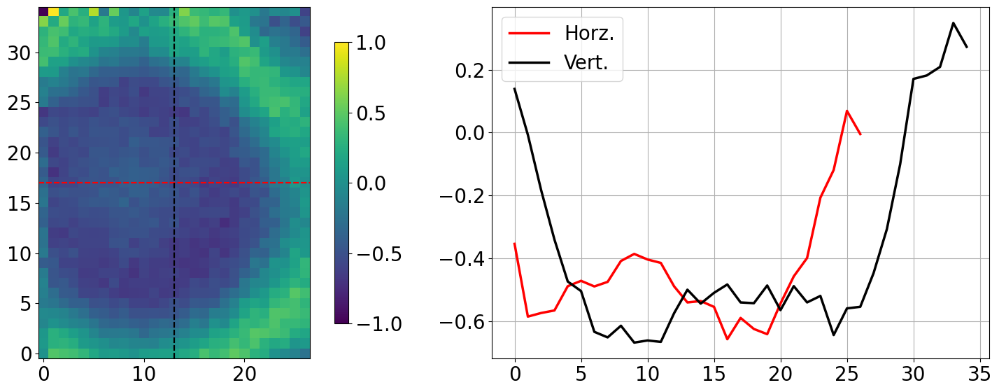

In [151]:
#recentering the detector horiztonally again
Rx,Ry = (90,360),(100,450)
center = int((Rx[1]+Rx[0])/2-Rx[0]),int((Ry[1]+Ry[0])/2-Ry[0])
up_all = fumi_reader(15091,direct=DEFAULT_DIRECT,ROI_x=(0,511),ROI_y=(0,511),plot=True)
up = fumi_reader(15091,direct=DEFAULT_DIRECT,ROI_x=Rx,ROI_y=Ry,plot=True)
down_all = fumi_reader(15092,direct=DEFAULT_DIRECT,ROI_x=(0,511),ROI_y=(0,511),plot=True)
down = fumi_reader(15092,direct=DEFAULT_DIRECT,ROI_x=Rx,ROI_y=Ry,plot=True)
#_ = get_pol(up,down,zero=True,plot=True)
print(f'Whole beam FR: {round(np.sum(up[0])/np.sum(down[0]),1)}')
print(f'Average counts per pixel: {round(np.mean(up[0]),2)}')
print(f'Beam center pixel: {center}')
print(f'X pixel num: {Rx[1]-Rx[0]}')
print(f'Y pixel num: {Ry[1]-Ry[0]}')

#print(f'Unbinned data:')
#pols = reduce_scan(15067,15069,ROI_x=Rx,ROI_y=Ry,reb=False)
#_ = [cross(p,None,range(center[0]-2,center[0]+2),range(center[1]-2,center[1]+2),plot=True) for p in pols]

print(f'Binned data:')
pols2 = reduce_scan(15091,15093,ROI_x=Rx,ROI_y=Ry,reb=True)
_ = [cross(p,None,range(center[0]//10,center[0]//10+1),range(center[1]//10,center[1]//10+1),plot=True) for p in pols2]

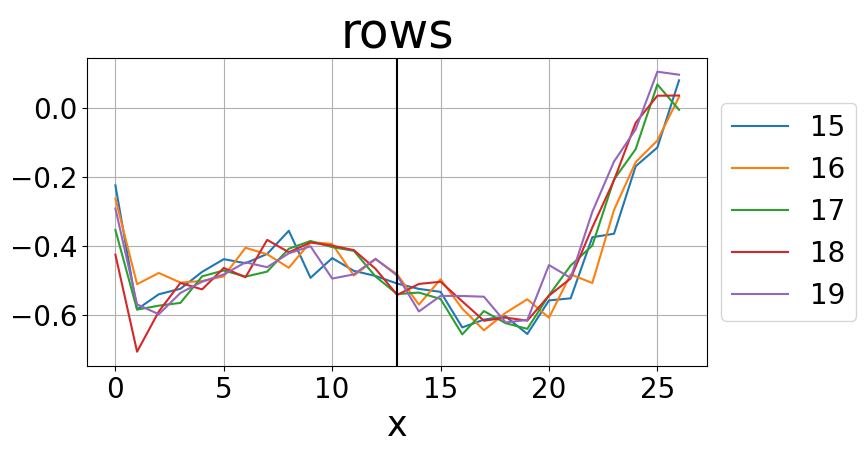

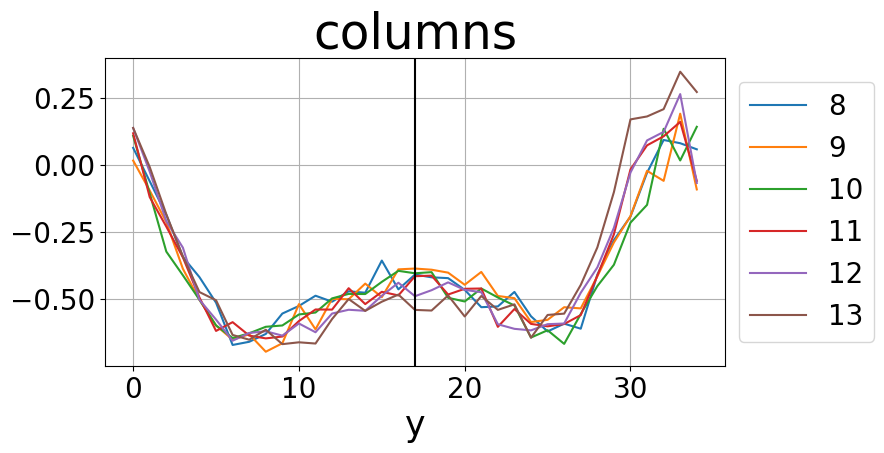

In [152]:
plt.figure(figsize=(8,4))
plt.title('rows')
for i in range(15,20):
    #plt.plot(range(3,23),pols2[0,i,3:-6],'-',label=f'{i}')
    plt.plot(pols2[0,i,:],'-',label=f'{i}')
plt.xlabel('x')
plt.axvline(x=center[0]//10,color='black')
ax = plt.gca()
ax.legend(loc='center left',bbox_to_anchor=(1,0.5))
plt.grid()
plt.show()

plt.figure(figsize=(8,4)) 
plt.title('columns')
for i in range(8,14):
    #plt.plot(range(5,27),pols2[0,5:-8,i],'-',label=f'{i}')
    plt.plot(pols2[0,:,i],'-',label=f'{i}')
plt.xlabel('y')
plt.axvline(x=center[1]//10,color='black')
ax = plt.gca()
ax.legend(loc='center left',bbox_to_anchor=(1,0.5))
plt.grid()
plt.show()

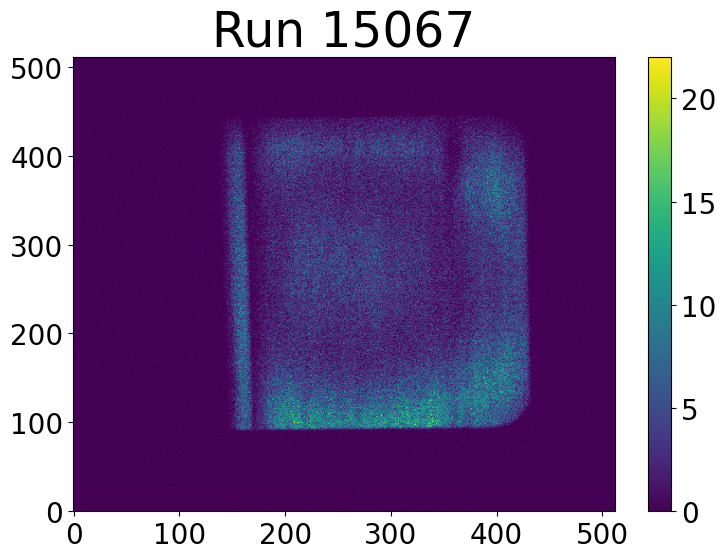

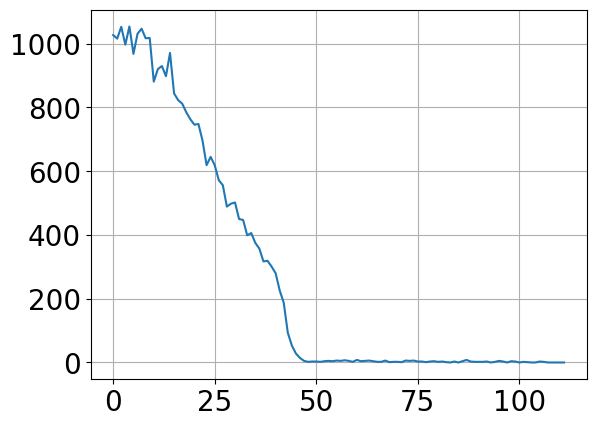

In [164]:
#finding the center of the detector
center = int((Rx[1]+Rx[0])/2-Rx[0]),int((Ry[1]+Ry[0])/2-Ry[0])
up_all = fumi_reader(15067,direct=DEFAULT_DIRECT,ROI_x=(0,512),ROI_y=(0,512),plot=True)[0]
plt.plot(np.sum(up_all,axis=1)[400:512])
#plt.plot(np.sum(up_all,axis=1))
plt.grid()
plt.show()

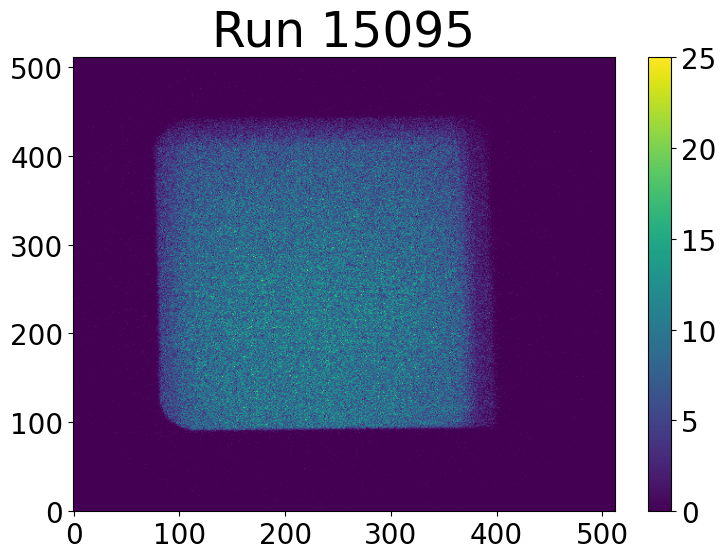

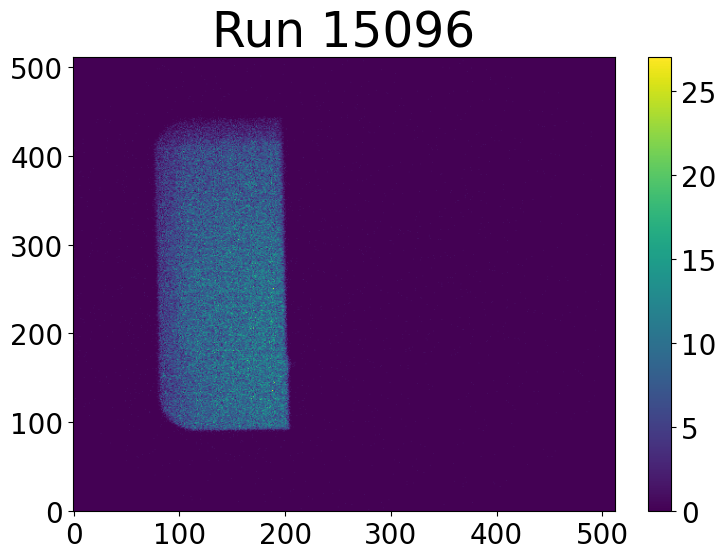

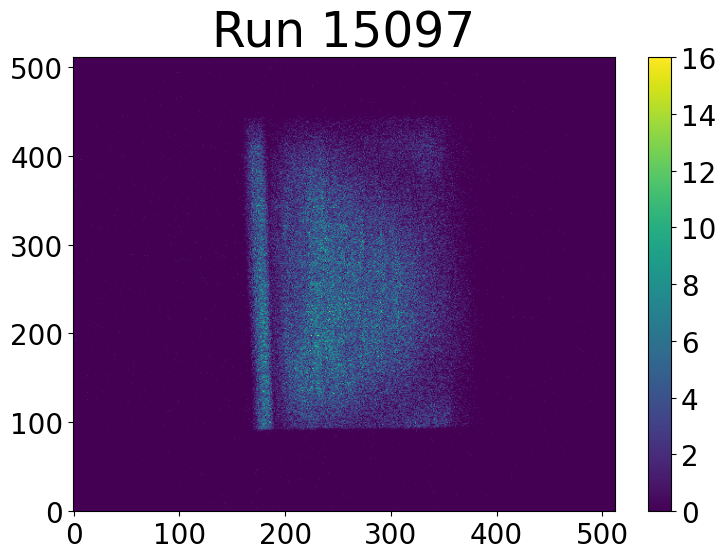

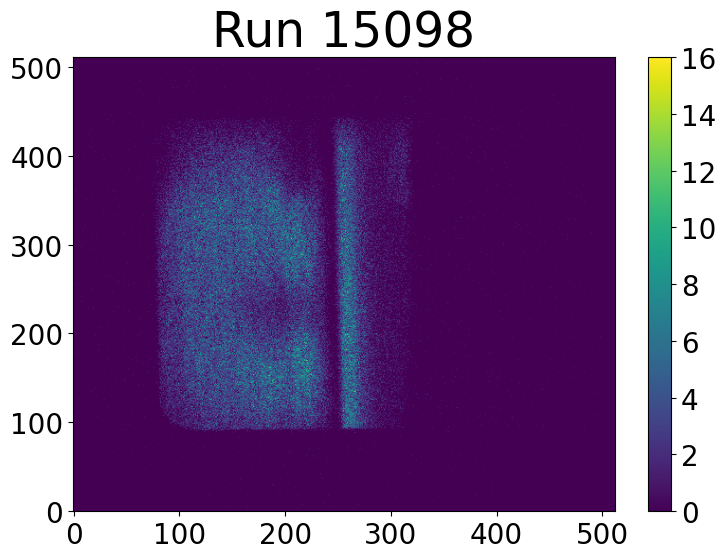

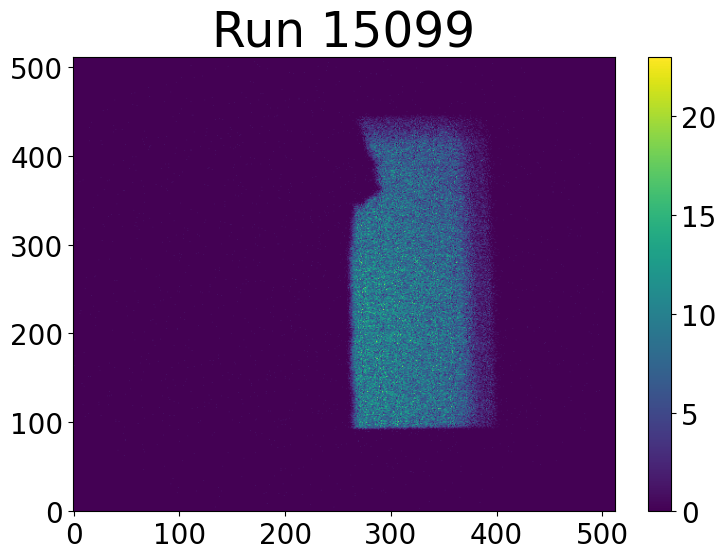

In [167]:
#scanning the sbender to fully illuminate the detector
center = int((Rx[1]+Rx[0])/2-Rx[0]),int((Ry[1]+Ry[0])/2-Ry[0])
for i in range(15095,15100):
    up_all = fumi_reader(i,direct=DEFAULT_DIRECT,ROI_x=(0,512),ROI_y=(0,512),plot=True)[0]

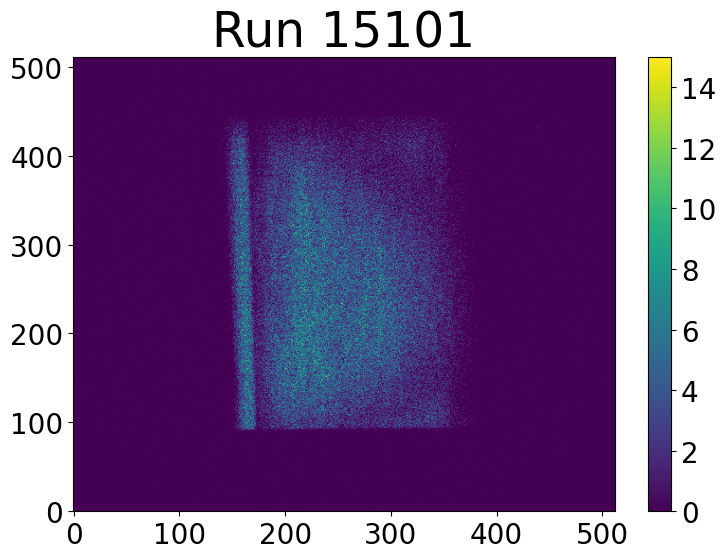

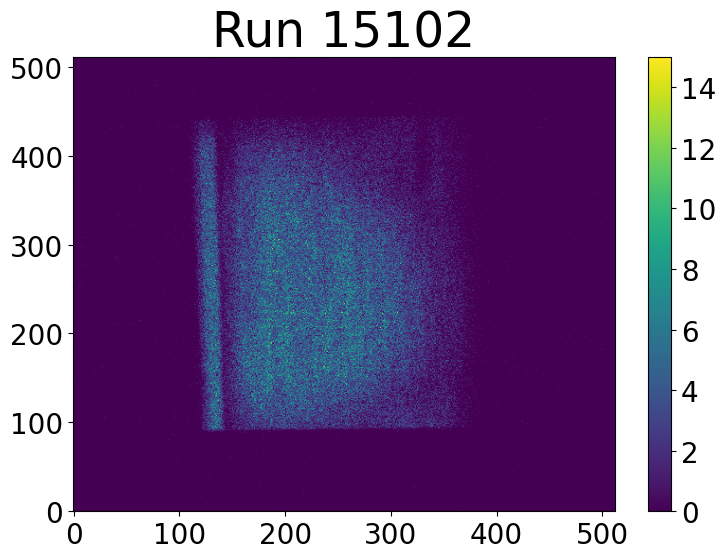

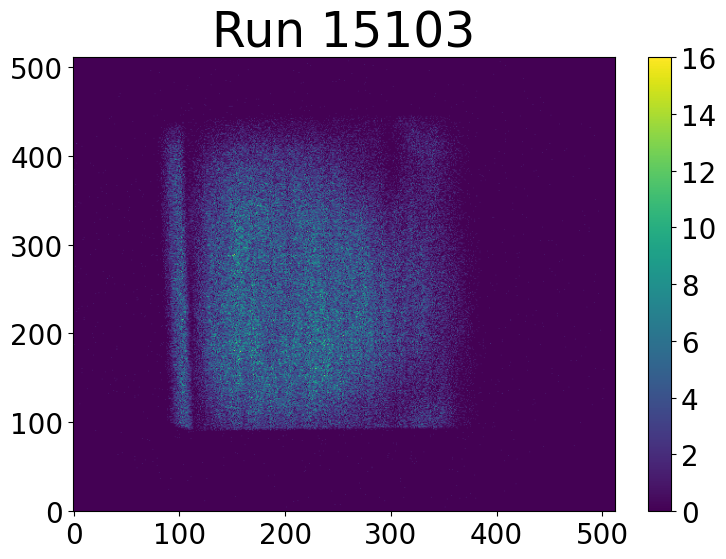

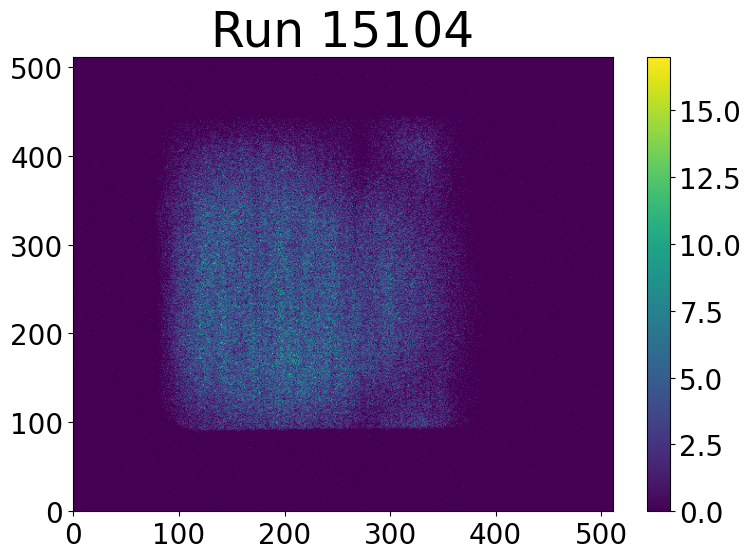

In [170]:
#scanning the sbender to fully illuminate the detector
center = int((Rx[1]+Rx[0])/2-Rx[0]),int((Ry[1]+Ry[0])/2-Ry[0])
for i in range(15101,15105):
    up_all = fumi_reader(i,direct=DEFAULT_DIRECT,ROI_x=(0,512),ROI_y=(0,512),plot=True)[0]

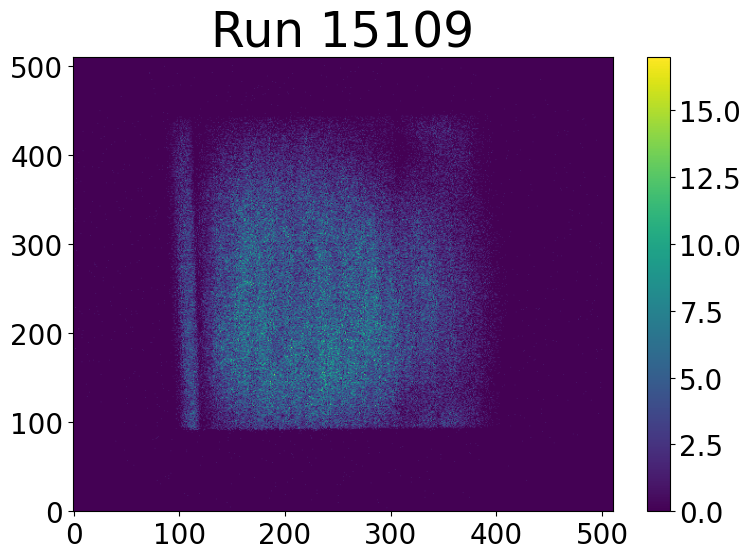

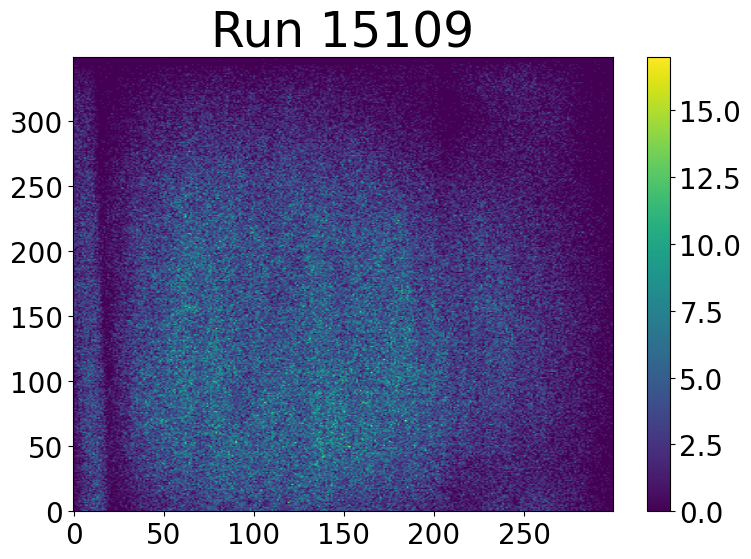

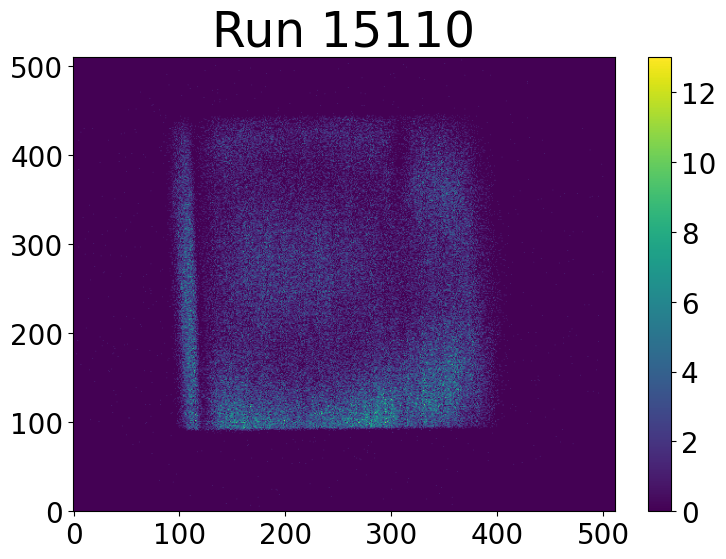

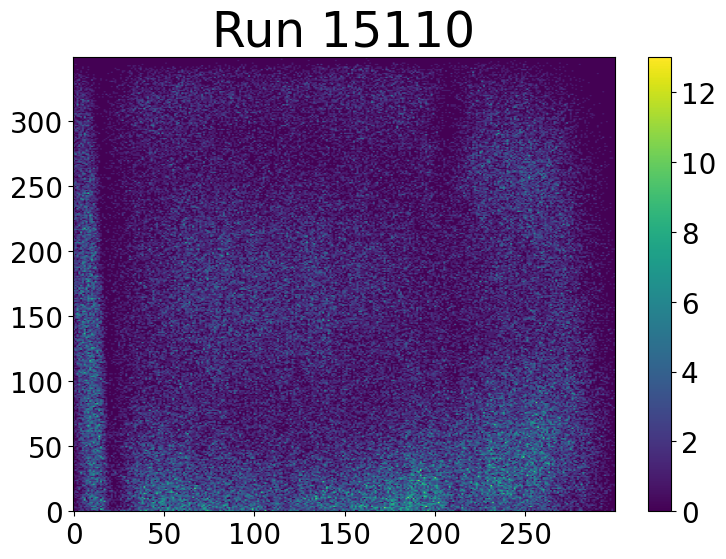

Whole beam FR: 2.0
Average counts per pixel: 2.7
Beam center pixel: (150, 175)
X pixel num: 300
Y pixel num: 350
Binned data:
Error calculation failed!


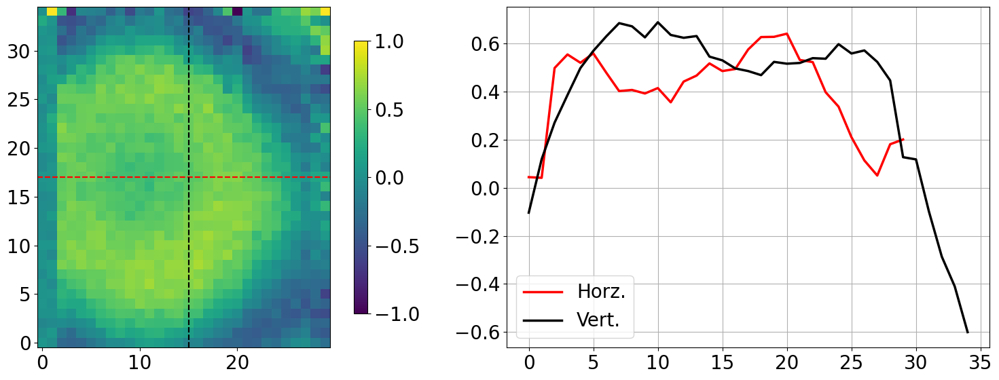

In [173]:
#after fixing the masks
Rx,Ry = (100,400),(100,450)
center = int((Rx[1]+Rx[0])/2-Rx[0]),int((Ry[1]+Ry[0])/2-Ry[0])
up_all = fumi_reader(15109,direct=DEFAULT_DIRECT,ROI_x=(0,511),ROI_y=(0,511),plot=True)
up = fumi_reader(15109,direct=DEFAULT_DIRECT,ROI_x=Rx,ROI_y=Ry,plot=True)
down_all = fumi_reader(15110,direct=DEFAULT_DIRECT,ROI_x=(0,511),ROI_y=(0,511),plot=True)
down = fumi_reader(15110,direct=DEFAULT_DIRECT,ROI_x=Rx,ROI_y=Ry,plot=True)
#_ = get_pol(up,down,zero=True,plot=True)
print(f'Whole beam FR: {round(np.sum(up[0])/np.sum(down[0]),1)}')
print(f'Average counts per pixel: {round(np.mean(up[0]),2)}')
print(f'Beam center pixel: {center}')
print(f'X pixel num: {Rx[1]-Rx[0]}')
print(f'Y pixel num: {Ry[1]-Ry[0]}')

print(f'Binned data:')
pols2 = reduce_scan(15109,15111,ROI_x=Rx,ROI_y=Ry,reb=True)
_ = [cross(p,None,range(center[0]//10,center[0]//10+1),range(center[1]//10,center[1]//10+1),plot=True) for p in pols2]

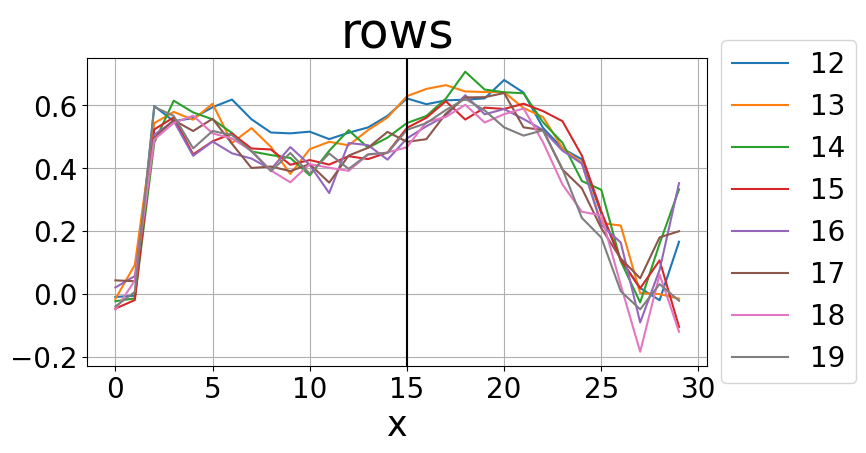

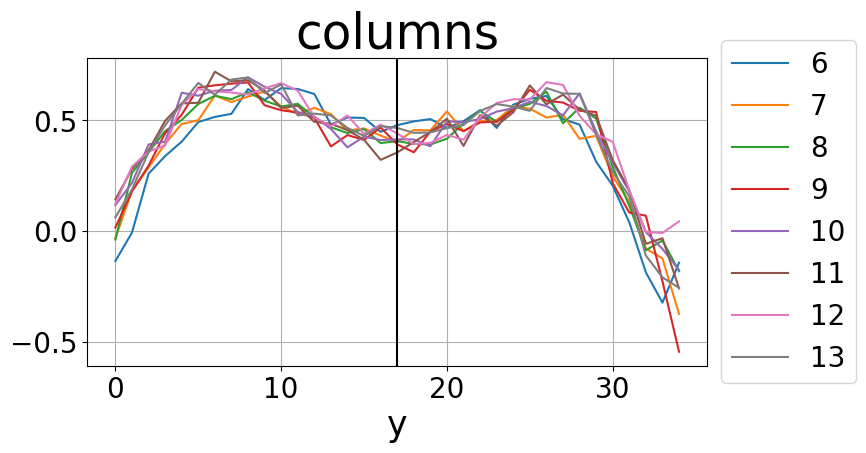

In [174]:
plt.figure(figsize=(8,4))
plt.title('rows')
for i in range(12,20):
    #plt.plot(range(3,23),pols2[0,i,3:-6],'-',label=f'{i}')
    plt.plot(pols2[0,i,:],'-',label=f'{i}')
plt.xlabel('x')
plt.axvline(x=center[0]//10,color='black')
ax = plt.gca()
ax.legend(loc='center left',bbox_to_anchor=(1,0.5))
plt.grid()
plt.show()

plt.figure(figsize=(8,4)) 
plt.title('columns')
for i in range(6,14):
    #plt.plot(range(5,27),pols2[0,5:-8,i],'-',label=f'{i}')
    plt.plot(pols2[0,:,i],'-',label=f'{i}')
plt.xlabel('y')
plt.axvline(x=center[1]//10,color='black')
ax = plt.gca()
ax.legend(loc='center left',bbox_to_anchor=(1,0.5))
plt.grid()
plt.show()

### Old

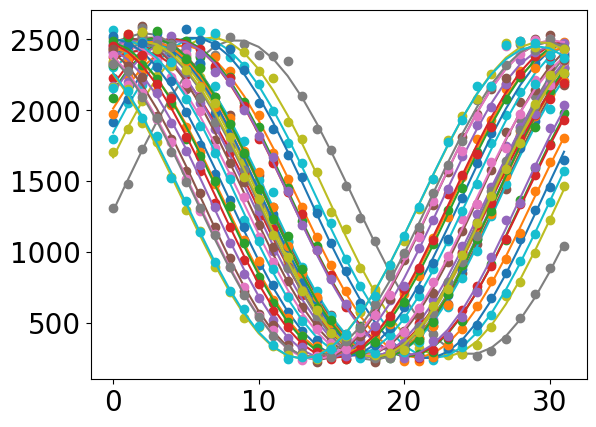

In [46]:
f = lambda x,amp,freq,phase,shim: cos(x,amp,freq,phase,shim,0)
time = np.arange(0,32)

guess = [1.109e+03,1.958e-01,-1.6583,1.386e+03] #intial guess

Rx,Ry = [190,340],[150,300]
images,phases,time_stamps,errors = [],[],[],[]
for i in range(2507,2540):
    images.append(np.sum(new_reduce(i,print_raw=False,print_summed=False,ROI_x=Rx,ROI_y=Ry),axis=(1,2)))
    time_stamps.append(spice_log_reader(i)[2])
    
    lb = (0,0,-10*np.pi,0)
    ub = (np.max(images[-1]),1,10*np.pi,np.max(images[-1]))
    bnds = (lb,ub)  #lower and upper bounds
    parms,errs = curve_fit(f,time,images[-1],p0=guess,bounds=bnds)
    guess = parms
    phases.append(parms[2])
    errors.append(np.sqrt(np.diag(errs))[2])
    plt.plot(images[-1],'o',color=f'C{i}')
    plt.plot(f(time,*parms),'-',color=f'C{i}')

plt.show()

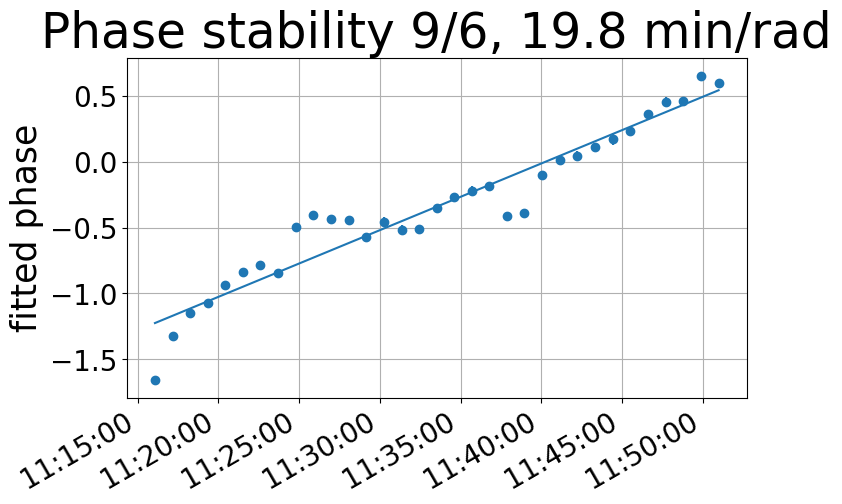

In [115]:
lin = lambda x,b,a: b*x + a
t = np.array([i.timestamp() for i in time_stamps])
parms,errs = curve_fit(lin,t,phases)
rel_time = datetime.fromtimestamp(1/parms[0])-datetime.fromtimestamp(0) #relative to epoch time
rel_time = str(round(rel_time.total_seconds()/60,1))

fig, ax = plt.subplots(figsize=(8,5))
plt.plot(time_stamps,phases,'o',color='C0')
plt.errorbar(time_stamps,phases,errors,ls='none',color='C0')
plt.plot(time_stamps,lin(t,*parms))
plt.title(f'Phase stability 9/6, {rel_time} min/rad')
plt.ylabel('fitted phase')
plt.gcf().autofmt_xdate()
ax.xaxis.set_major_formatter(dates.DateFormatter("%H:%M:%S"))
plt.grid()
plt.show()